# 2023-04-10


## [3] 데이터셋 분리 및 모델 설계


1. 데이터 불러오기
2. 데이터셋 분리(x, y)
3. train, test 분리
4. 모델 설계 및 학습

In [1]:
import os
import numpy as np
import pandas as pd
import cv2
import matplotlib.pyplot as plt

In [2]:
import sklearn

## 1. 데이터셋 불러오기

In [14]:
# df_sample = pd.read_csv('./data/total/3_1_csv/squat_skeleton000.csv')
# df_sample

,Unnamed: 0,0,1,2,3,4,5,6,7,8,...,12,13,14,15,16,17,18,19,20,21
0,0,0.48919,0.16059,0.61322,0.25890,0.35582,0.26689,0.57819,0.50933,0.40289,...,0.35083,0.71906,0.66521,0.89063,0.31750,0.89752,0.77351,0.95428,0.22593,0.96713
1,1,0.49163,0.16628,0.61065,0.26227,0.35769,0.26975,0.57721,0.50601,0.40038,...,0.35245,0.71909,0.66995,0.89037,0.31936,0.89529,0.77325,0.95728,0.22997,0.96488
2,2,0.49316,0.16503,0.61507,0.26085,0.35974,0.26356,0.57302,0.50594,0.40222,...,0.35336,0.71335,0.66339,0.88898,0.32171,0.88589,0.77177,0.95322,0.23218,0.95883
3,3,0.48892,0.16060,0.61782,0.25734,0.36460,0.26332,0.57428,0.50715,0.39885,...,0.35030,0.71245,0.66759,0.88732,0.32016,0.89072,0.77949,0.95316,0.22272,0.96346
4,4,0.49480,0.17635,0.61342,0.26889,0.36214,0.27765,0.57676,0.51873,0.40431,...,0.32796,0.69363,0.67339,0.88687,0.32720,0.89166,0.79428,0.95257,0.22187,0.96048
5,5,0.48943,0.25601,0.63725,0.35166,0.34624,0.35736,0.57755,0.58792,0.39657,...,0.24506,0.72636,0.68440,0.90020,0.30141,0.90502,0.80142,0.95183,0.20816,0.96640
6,6,0.48558,0.37706,0.63720,0.46092,0.33456,0.46502,0.58080,0.66779,0.39735,...,0.19607,0.75728,0.68085,0.89946,0.31003,0.90448,0.79605,0.95214,0.21249,0.96406
7,7,0.48649,0.45039,0.64286,0.53784,0.34203,0.54252,0.58648,0.72742,0.42370,...,0.19989,0.75606,0.68974,0.89698,0.31469,0.89966,0.79344,0.95027,0.21757,0.96391
8,8,0.49162,0.46921,0.64189,0.55912,0.33913,0.55958,0.58638,0.74649,0.42208,...,0.20591,0.76167,0.69248,0.89828,0.31348,0.90253,0.79119,0.94583,0.22030,0.96077
9,9,0.49563,0.46400,0.64345,0.55170,0.34134,0.55344,0.59011,0.74098,0.42526,...,0.20621,0.75758,0.68184,0.89899,0.31763,0.90358,0.78827,0.95057,0.22013,0.96460


In [15]:
# df_sample.set_index('Unnamed: 0', inplace=True)
# df_sample

,0,1,2,3,4,5,6,7,8,9,...,12,13,14,15,16,17,18,19,20,21
Unnamed: 0,,,,,,,,,,,,,,,,,,,,,
0,0.48919,0.16059,0.61322,0.25890,0.35582,0.26689,0.57819,0.50933,0.40289,0.51002,...,0.35083,0.71906,0.66521,0.89063,0.31750,0.89752,0.77351,0.95428,0.22593,0.96713
1,0.49163,0.16628,0.61065,0.26227,0.35769,0.26975,0.57721,0.50601,0.40038,0.50728,...,0.35245,0.71909,0.66995,0.89037,0.31936,0.89529,0.77325,0.95728,0.22997,0.96488
2,0.49316,0.16503,0.61507,0.26085,0.35974,0.26356,0.57302,0.50594,0.40222,0.50679,...,0.35336,0.71335,0.66339,0.88898,0.32171,0.88589,0.77177,0.95322,0.23218,0.95883
3,0.48892,0.16060,0.61782,0.25734,0.36460,0.26332,0.57428,0.50715,0.39885,0.50679,...,0.35030,0.71245,0.66759,0.88732,0.32016,0.89072,0.77949,0.95316,0.22272,0.96346
4,0.49480,0.17635,0.61342,0.26889,0.36214,0.27765,0.57676,0.51873,0.40431,0.52089,...,0.32796,0.69363,0.67339,0.88687,0.32720,0.89166,0.79428,0.95257,0.22187,0.96048
5,0.48943,0.25601,0.63725,0.35166,0.34624,0.35736,0.57755,0.58792,0.39657,0.59001,...,0.24506,0.72636,0.68440,0.90020,0.30141,0.90502,0.80142,0.95183,0.20816,0.96640
6,0.48558,0.37706,0.63720,0.46092,0.33456,0.46502,0.58080,0.66779,0.39735,0.67057,...,0.19607,0.75728,0.68085,0.89946,0.31003,0.90448,0.79605,0.95214,0.21249,0.96406
7,0.48649,0.45039,0.64286,0.53784,0.34203,0.54252,0.58648,0.72742,0.42370,0.72943,...,0.19989,0.75606,0.68974,0.89698,0.31469,0.89966,0.79344,0.95027,0.21757,0.96391
8,0.49162,0.46921,0.64189,0.55912,0.33913,0.55958,0.58638,0.74649,0.42208,0.74985,...,0.20591,0.76167,0.69248,0.89828,0.31348,0.90253,0.79119,0.94583,0.22030,0.96077


In [16]:
# df_sample.shape[0]

15

In [6]:
# # (연습)모델에 학습 가능한 형태인 1차원 넘파이 배열 형태로 변경하기

# sample = df1.iloc[0:3]
# print(f'sample shape = {sample.shape}')

# # 1. 넘파이 배열로 바꾸기
# sample_list = np.array(sample)
# print(f'sample_list shape = {sample_list.shape}')

# # 2. flatten
# sample_list2 = sample_list.flatten()
# print(f'sample_list2 shape = {sample_list2.shape}')

# # 3. reshape
# sample_list3 = sample_list2.reshape(sample_list.shape)
# print(f'sample_list3 shape = {sample_list3.shape}')
# sample_list3

sample shape = (3, 22)
sample_list shape = (3, 22)
sample_list2 shape = (66,)
sample_list3 shape = (3, 22)


array([[0.48919, 0.16059, 0.61322, 0.2589 , 0.35582, 0.26689, 0.57819,
        0.50933, 0.40289, 0.51002, 0.63191, 0.71523, 0.35083, 0.71906,
        0.66521, 0.89063, 0.3175 , 0.89752, 0.77351, 0.95428, 0.22593,
        0.96713],
       [0.49163, 0.16628, 0.61065, 0.26227, 0.35769, 0.26975, 0.57721,
        0.50601, 0.40038, 0.50728, 0.6339 , 0.71535, 0.35245, 0.71909,
        0.66995, 0.89037, 0.31936, 0.89529, 0.77325, 0.95728, 0.22997,
        0.96488],
       [0.49316, 0.16503, 0.61507, 0.26085, 0.35974, 0.26356, 0.57302,
        0.50594, 0.40222, 0.50679, 0.62634, 0.71251, 0.35336, 0.71335,
        0.66339, 0.88898, 0.32171, 0.88589, 0.77177, 0.95322, 0.23218,
        0.95883]])

In [11]:
# sample_list

array([[0.48919, 0.16059, 0.61322, 0.2589 , 0.35582, 0.26689, 0.57819,
        0.50933, 0.40289, 0.51002, 0.63191, 0.71523, 0.35083, 0.71906,
        0.66521, 0.89063, 0.3175 , 0.89752, 0.77351, 0.95428, 0.22593,
        0.96713],
       [0.49163, 0.16628, 0.61065, 0.26227, 0.35769, 0.26975, 0.57721,
        0.50601, 0.40038, 0.50728, 0.6339 , 0.71535, 0.35245, 0.71909,
        0.66995, 0.89037, 0.31936, 0.89529, 0.77325, 0.95728, 0.22997,
        0.96488],
       [0.49316, 0.16503, 0.61507, 0.26085, 0.35974, 0.26356, 0.57302,
        0.50594, 0.40222, 0.50679, 0.62634, 0.71251, 0.35336, 0.71335,
        0.66339, 0.88898, 0.32171, 0.88589, 0.77177, 0.95322, 0.23218,
        0.95883]])

In [18]:
# # 1. 경로에서 csv 파일만 불러온다.

# csv_path = './data/total/3_1_csv/'
# csv_name = []

# for i in sorted(os.listdir(csv_path)):
#     if i[-3:] == 'csv':
#         csv_name.append(i)
        
# print(f'csv count : {len(csv_name)}')
# # csv_name

# # 2. csv파일을 데이터프레임으로 불러온다. (df000, df001, ... , df072)

# for i in range(len(csv_name)):
#     if i < 10:
#         globals()[f'df00{i}'] = pd.read_csv(csv_path + csv_name[i])
#         globals()[f'df00{i}'].set_index('Unnamed: 0', inplace=True)
#     elif i < 100:
#         globals()[f'df0{i}'] = pd.read_csv(csv_path + csv_name[i])
#         globals()[f'df0{i}'].set_index('Unnamed: 0', inplace=True)
#     else:
#         globals()[f'df{i}'] = pd.read_csv(csv_path + csv_name[i])
#         globals()[f'df{i}'].set_index('Unnamed: 0', inplace=True)
        

csv count : 73


In [3]:
# 1. 경로에서 csv 파일만 불러온다.

csv_path = './data/total_0511/3_csv/'
csv_name = []

for i in sorted(os.listdir(csv_path)):
    if i[-3:] == 'csv':
        csv_name.append(i)
        
print(f'csv count : {len(csv_name)}')
# csv_name

# 2. csv파일을 데이터프레임으로 불러온다. (df000, df001, ... , df072)

for i in csv_name:
    globals()[f'df{i[14:-4]}'] = pd.read_csv(csv_path + i)
    globals()[f'df{i[14:-4]}'].set_index('Unnamed: 0', inplace=True)


csv count : 88


In [9]:
# csv 넘버링

# csv_path = './data/total/3_csv/0508_skeleton/'
# new_path = './data/total/3_csv/0508_skeleton/'
# csv_name = []

# for i in sorted(os.listdir(csv_path)):
#     if i[-3:] == 'csv':
#         csv_name.append(i)
        
# print(f'csv count : {len(csv_name)}')
# # csv_name

# for i in range(len(csv_name)):
#     old_name = csv_path + csv_name[i]
#     if i+33 < 10:
#         new_name = new_path + f'squat_skeleton00{i+33}.csv'
#     elif i+33< 100:
#         new_name = new_path + f'squat_skeleton0{i+33}.csv'
#     else:
#         new_name = new_path + f'squat_skeleton{i+33}.csv'
        
#     os.rename(old_name, new_name)

csv count : 40


In [8]:
# csv_path = './data/csv/skeleton_squat/'

# for no, i in enumerate(csv_name):
#     file_path = csv_path + i
#     num = csv_name[no][-6:-4]
#     globals()[f'df{num}'] = pd.read_csv(file_path)
#     globals()[f'df{num}'].set_index('Unnamed: 0', inplace=True)

In [10]:
# csv_name[30][-6:-4]

'64'

In [4]:
df080

,0,1,2,3,4,5,6,7,8,9,...,12,13,14,15,16,17,18,19,20,21
Unnamed: 0,,,,,,,,,,,,,,,,,,,,,
0,0.48738,0.19297,0.53840,0.28997,0.44758,0.28994,0.51585,0.52275,0.46163,0.51896,...,0.44659,0.68504,0.55550,0.84633,0.42957,0.84823,0.57986,0.89725,0.40547,0.89941
1,0.48646,0.19456,0.53728,0.29043,0.44693,0.29001,0.51613,0.51825,0.46287,0.51542,...,0.44761,0.68596,0.55592,0.84643,0.42954,0.84803,0.58261,0.89776,0.40683,0.89740
2,0.48722,0.19805,0.53644,0.29241,0.44658,0.29441,0.51617,0.52284,0.46225,0.52001,...,0.44183,0.68873,0.55554,0.84839,0.42819,0.84662,0.58322,0.89838,0.40474,0.89746
3,0.48831,0.21610,0.53644,0.30534,0.44589,0.30504,0.51689,0.53768,0.46328,0.53532,...,0.43504,0.69540,0.55713,0.84490,0.42901,0.84785,0.58049,0.89740,0.40535,0.89822
4,0.48950,0.27667,0.53633,0.36138,0.44833,0.36390,0.51942,0.58404,0.46532,0.58283,...,0.42331,0.70157,0.55650,0.84701,0.42975,0.85416,0.58069,0.89555,0.40411,0.90178
5,0.49218,0.33493,0.53461,0.41325,0.45424,0.41876,0.51835,0.61649,0.46684,0.61659,...,0.41593,0.71031,0.55663,0.85018,0.42858,0.85267,0.58185,0.89576,0.40334,0.89633
6,0.49307,0.38396,0.53429,0.45842,0.45743,0.46280,0.51670,0.65263,0.46545,0.65314,...,0.41661,0.71828,0.55670,0.85246,0.42863,0.85437,0.58248,0.89390,0.40456,0.89557
7,0.49341,0.42656,0.53141,0.49607,0.45840,0.49919,0.51660,0.68191,0.46518,0.68145,...,0.41605,0.71887,0.55596,0.85434,0.42821,0.85516,0.58060,0.89631,0.40445,0.89506
8,0.49240,0.44721,0.53053,0.51666,0.45843,0.52069,0.51603,0.69606,0.46608,0.69525,...,0.41819,0.71814,0.55735,0.85487,0.42815,0.85683,0.57894,0.89588,0.40372,0.89547


In [30]:
# import os

# path = './data/total/temp/'

# lst = sorted(os.listdir(path))
# lst2 = []

# for i in lst:
#     if i == '.DS_Store':
#         pass
#     else:
#         lst2.append(i)
        
# # lst2

# for i in range(len(lst2)):
#     old_name = path + lst2[i]
#     if i+34 < 10:
#         new_name = f'./data/total/2_2_image/00{i+34}'
#     elif i+34 < 100:
#         new_name = f'./data/total/2_2_image/0{i+34}'
#     else:
#         new_name = f'./data/total/2_2_image/{i+34}'
#     print(new_name)
        
#     os.rename(old_name, new_name)

./data/total/2_2_image/034
./data/total/2_2_image/035
./data/total/2_2_image/036
./data/total/2_2_image/037
./data/total/2_2_image/038
./data/total/2_2_image/039
./data/total/2_2_image/040
./data/total/2_2_image/041
./data/total/2_2_image/042
./data/total/2_2_image/043
./data/total/2_2_image/044
./data/total/2_2_image/045
./data/total/2_2_image/046
./data/total/2_2_image/047
./data/total/2_2_image/048
./data/total/2_2_image/049
./data/total/2_2_image/050
./data/total/2_2_image/051
./data/total/2_2_image/052
./data/total/2_2_image/053
./data/total/2_2_image/054
./data/total/2_2_image/055
./data/total/2_2_image/056
./data/total/2_2_image/057
./data/total/2_2_image/058
./data/total/2_2_image/059
./data/total/2_2_image/060
./data/total/2_2_image/061
./data/total/2_2_image/062
./data/total/2_2_image/063
./data/total/2_2_image/064
./data/total/2_2_image/065
./data/total/2_2_image/066
./data/total/2_2_image/067
./data/total/2_2_image/068
./data/total/2_2_image/069
./data/total/2_2_image/070
.

<br><br>

### 결과 확인 : 이미지에 포인트 그려서 확인하기

n = 021


AttributeError: 'NoneType' object has no attribute 'shape'

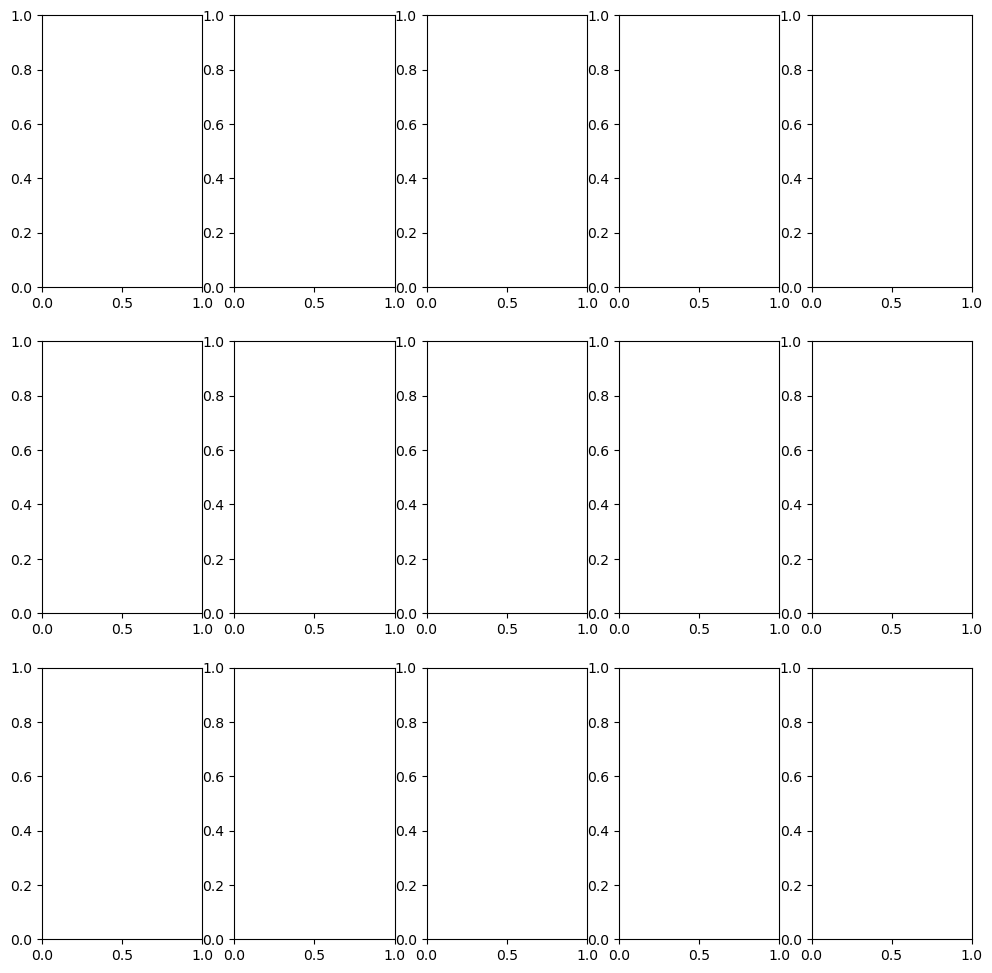

In [77]:
# # n = np.random.randint(0, len(csv_name))
# n = 21

# if n < 10:
#     n = f'00{n}'
# elif n < 100:
#     n = f'0{n}'
# else:
#     n = f'{n}'
# print(f'n = {n}')

# img_list = os.listdir(f'./data/total/2_2_image/{n}/')
# img_list = sorted(img_list)
# fig, ax = plt.subplots(3, 5, figsize = (12,12))

# for i in range(globals()[f'df{n}'].shape[0]):
    
#     background = cv2.imread(f'./data/total/2_2_image/{n}/' + img_list[i])
# #     img_array = np.fromfile(f'./data/total/2_2_image/{n}/' + img_list[i], np.uint8)
# #     background = cv2.imdecode(img_array,  cv2.IMREAD_COLOR)
# #     background = cv2.cvtColor(background, cv2.COLOR_BGR2RGB)
#     temp = globals()[f'df{n}'].iloc[i]
#     temp = np.array(temp)
#     temp = temp.reshape(11, 2)
    
#     for j in temp:
#         cx = int(j[0]*background.shape[1])
#         cy = int(j[1]*background.shape[0])
#         cv2.circle(background, (cx, cy), radius=5, color=(255,0,0), thickness=10)
    
#     plt.subplot(3, 5, i + 1)
#     plt.imshow(background)
#     plt.axis('off')

n = 000


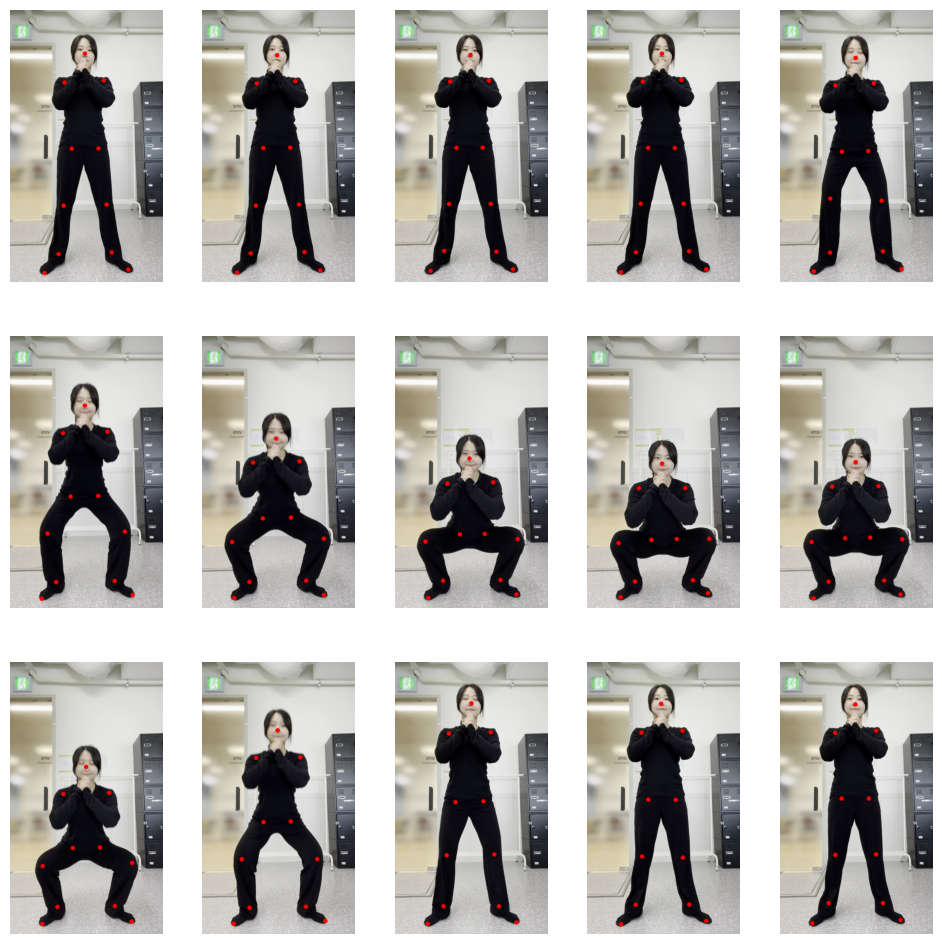

n = 001


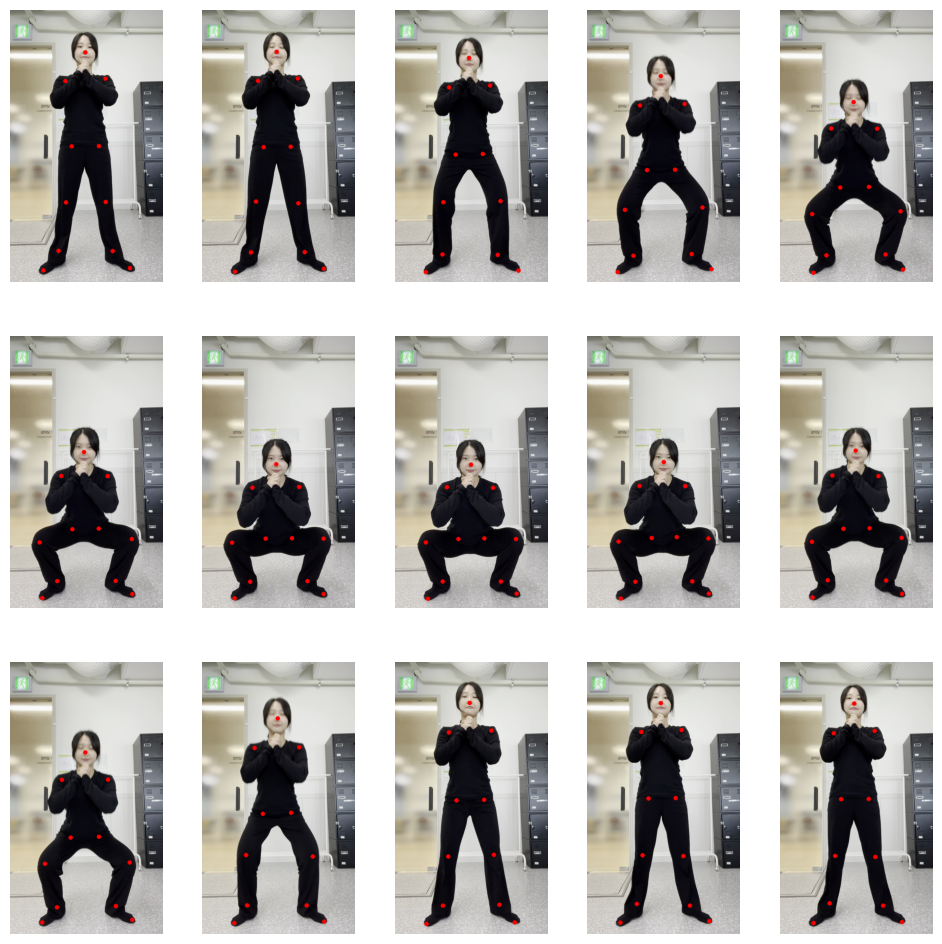

n = 002


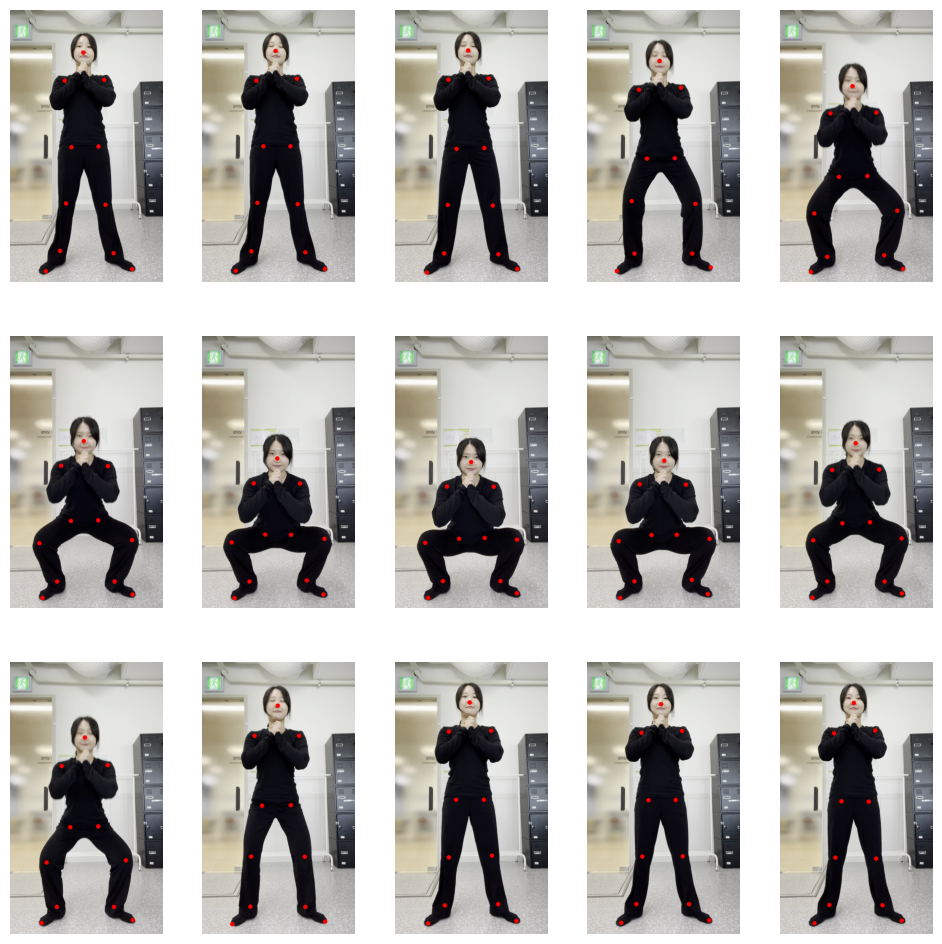

n = 003


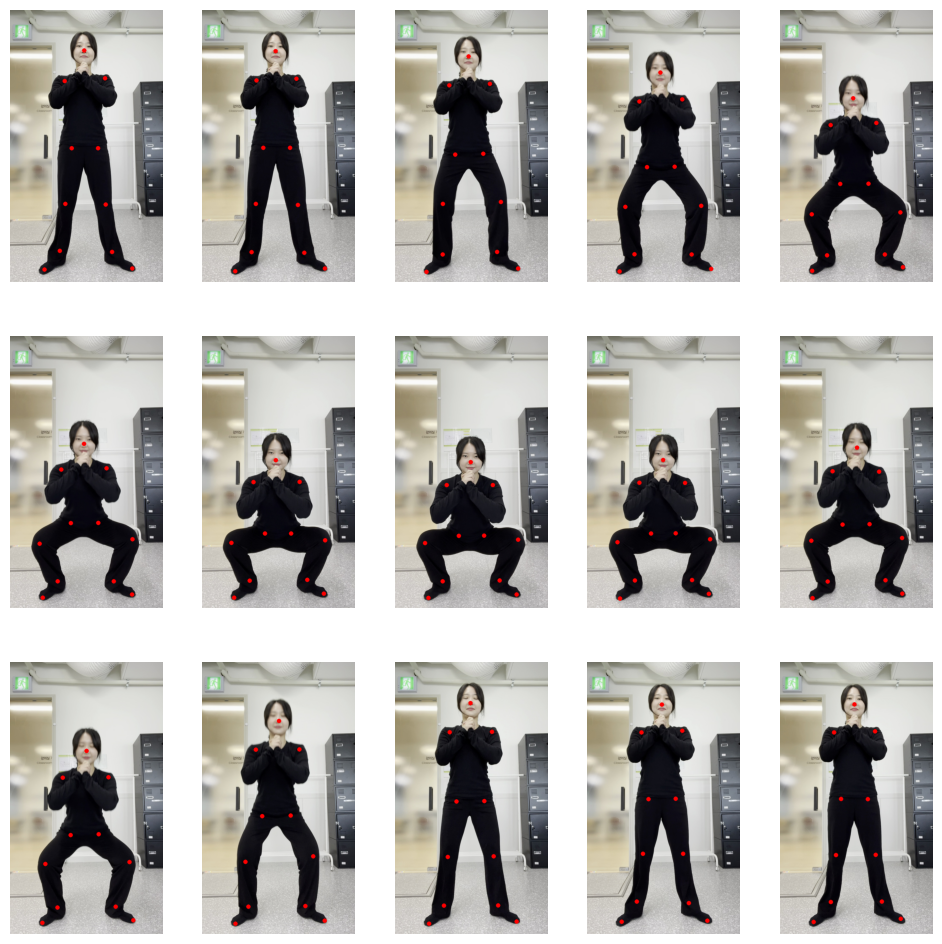

n = 004


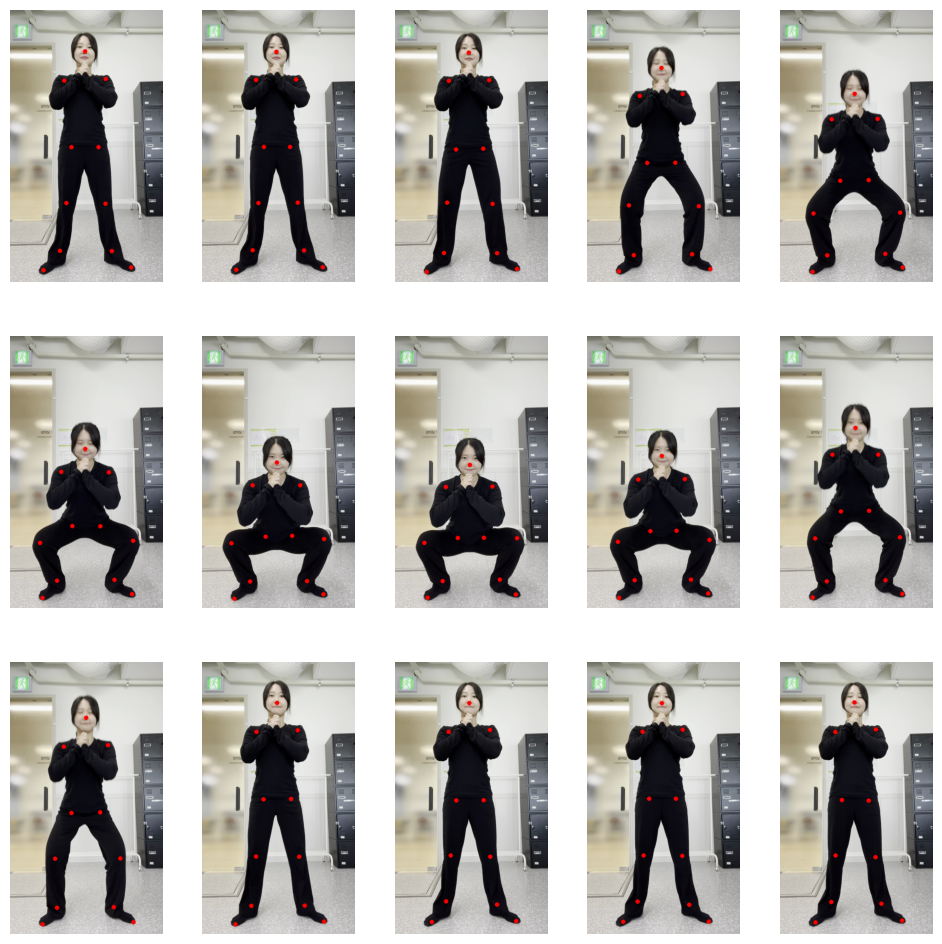

n = 005


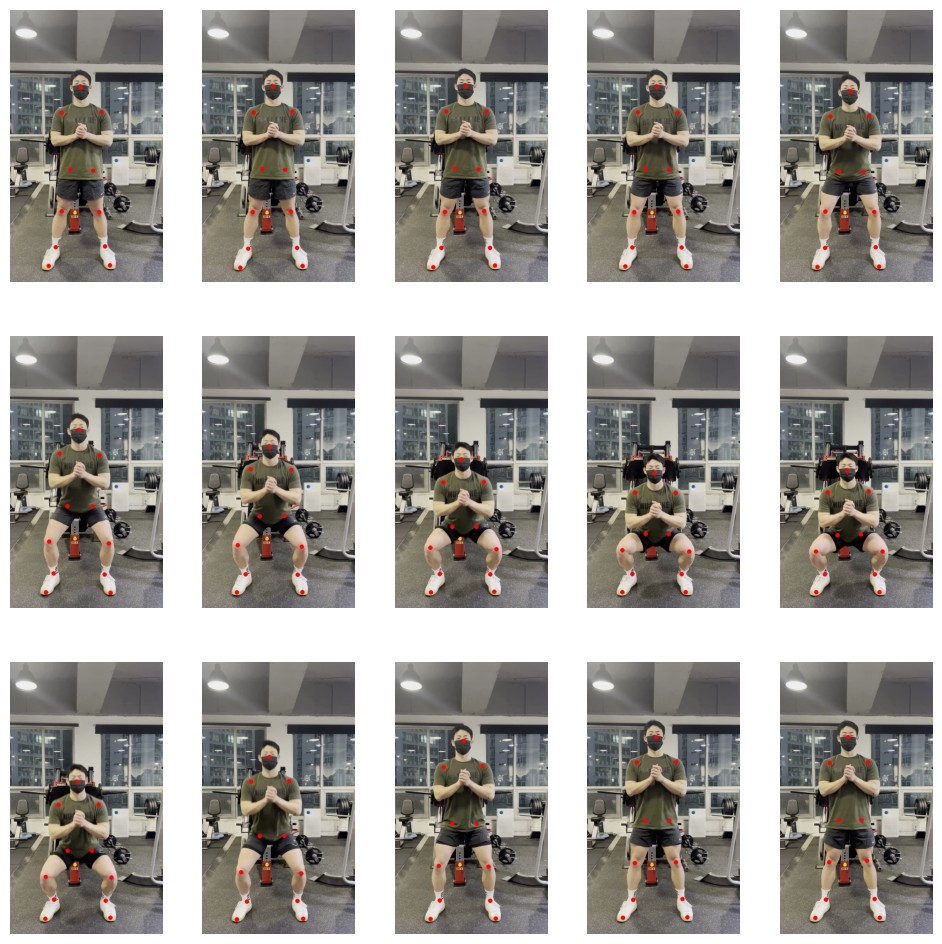

n = 006


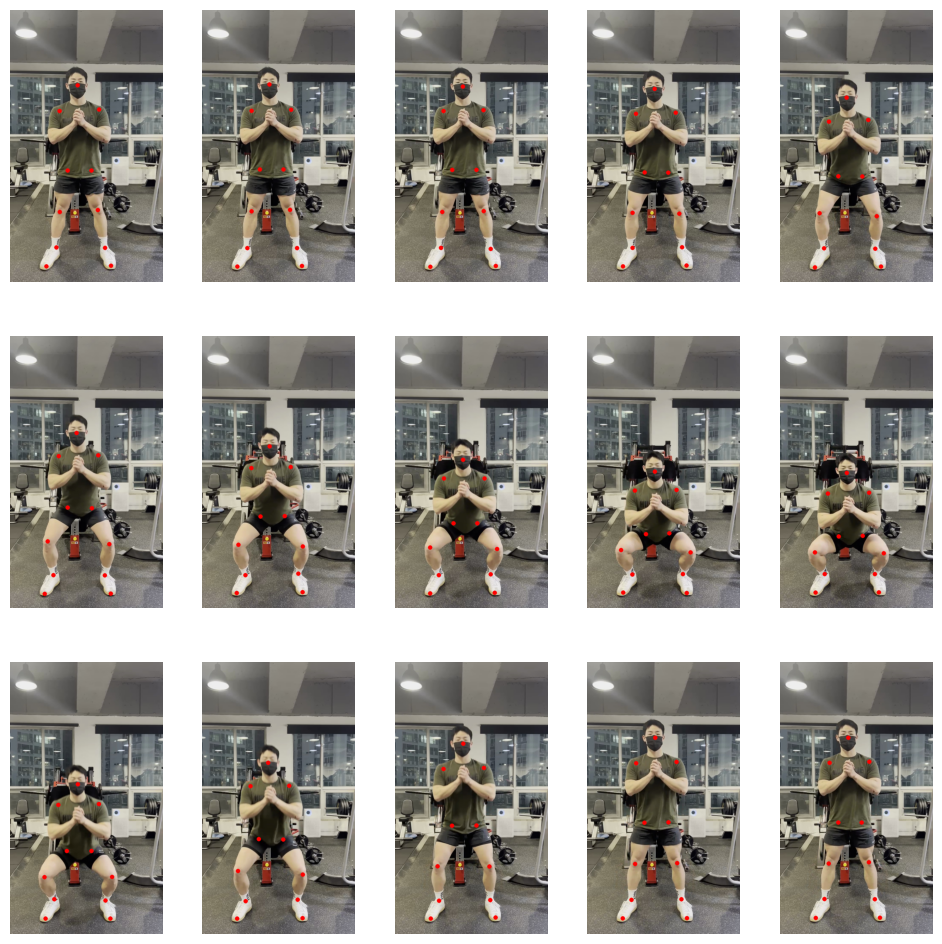

n = 007


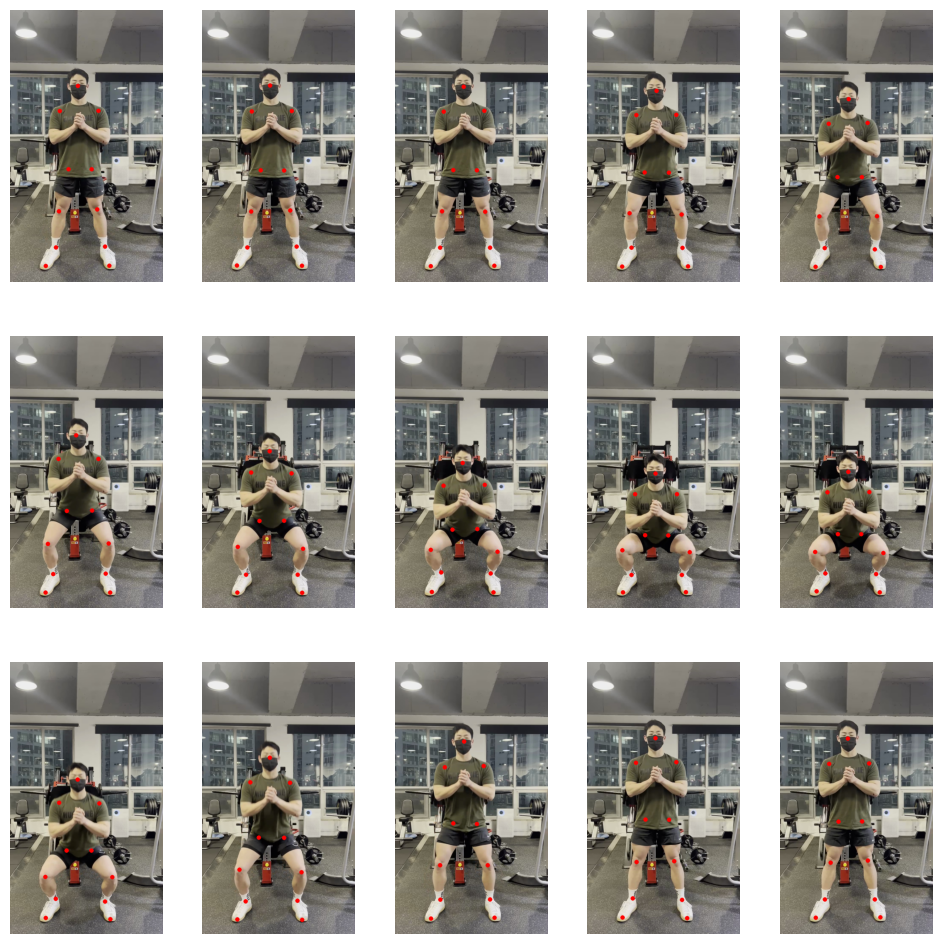

n = 008


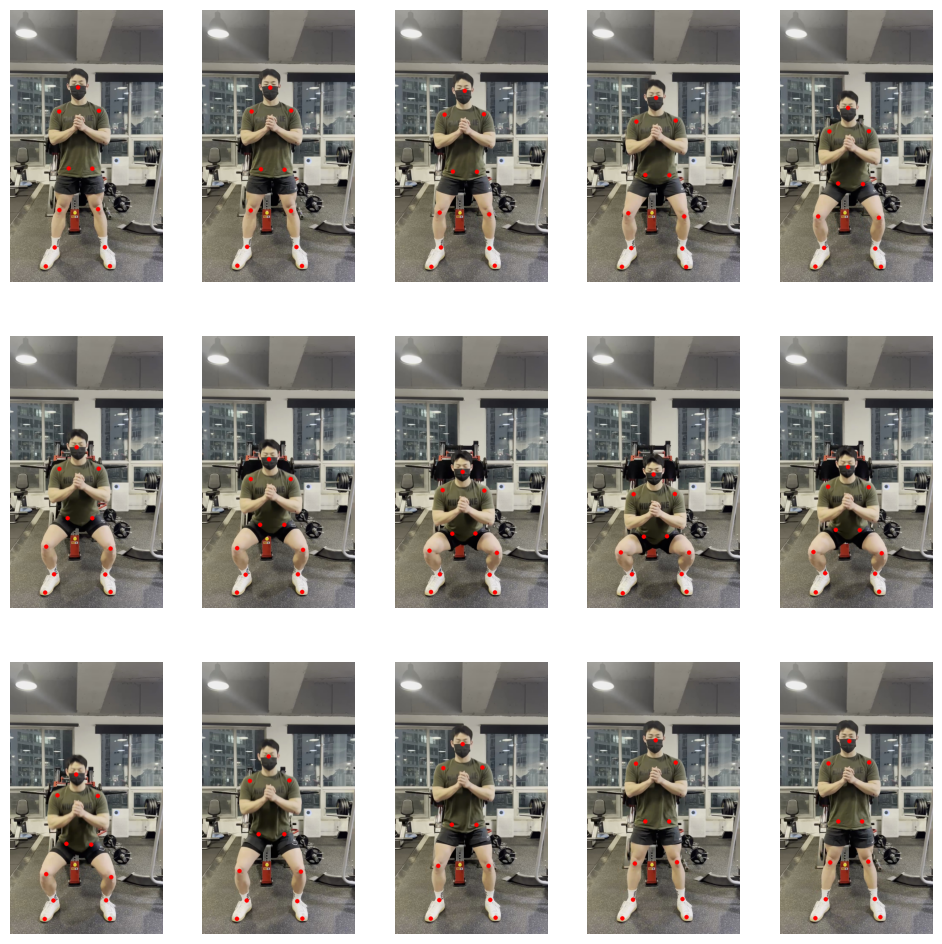

n = 009


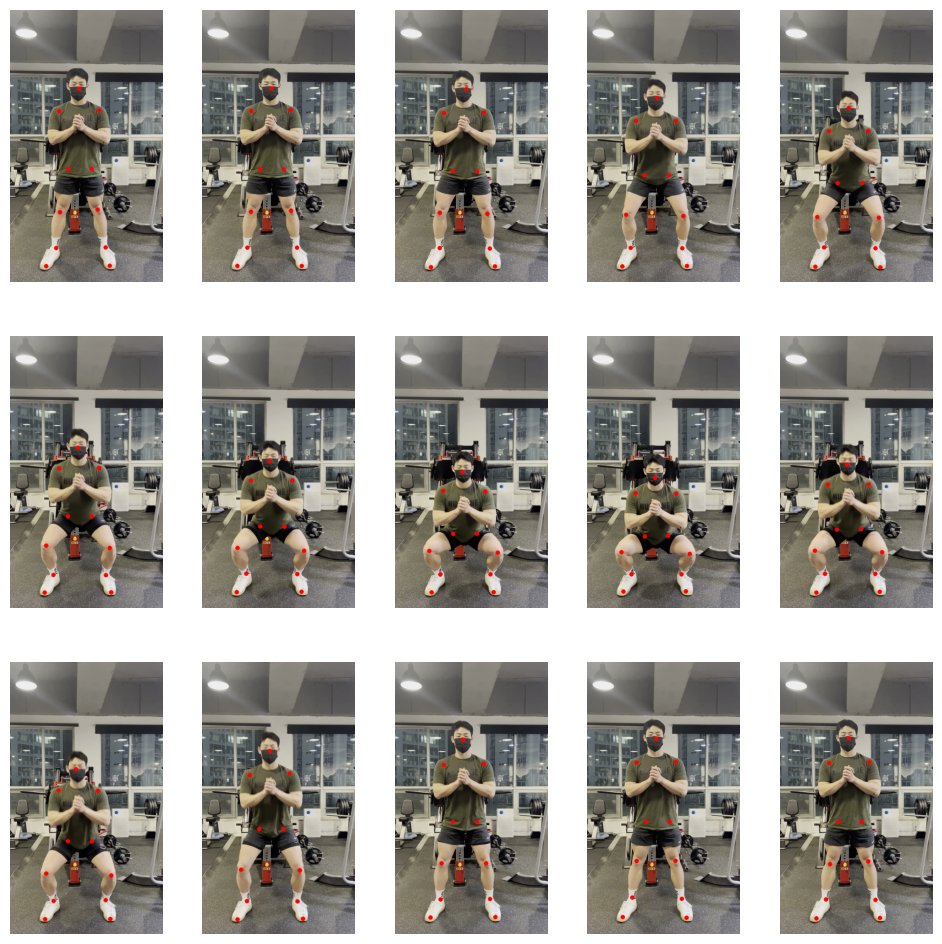

n = 010


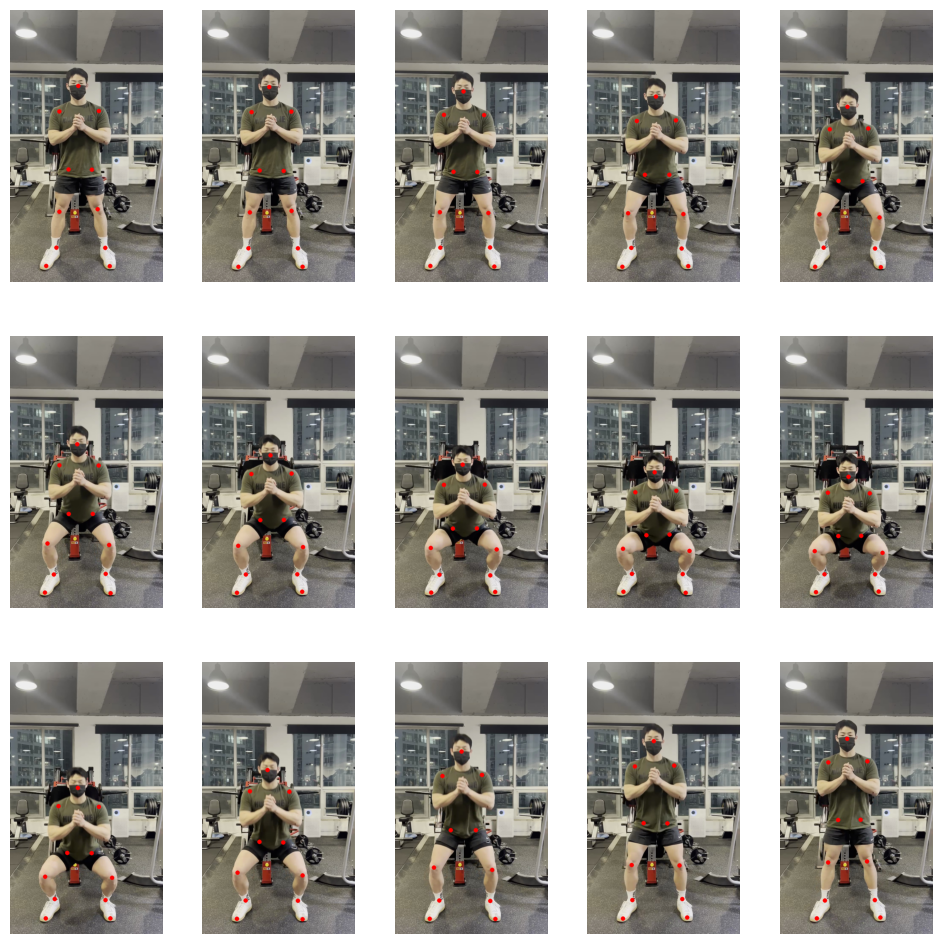

n = 011


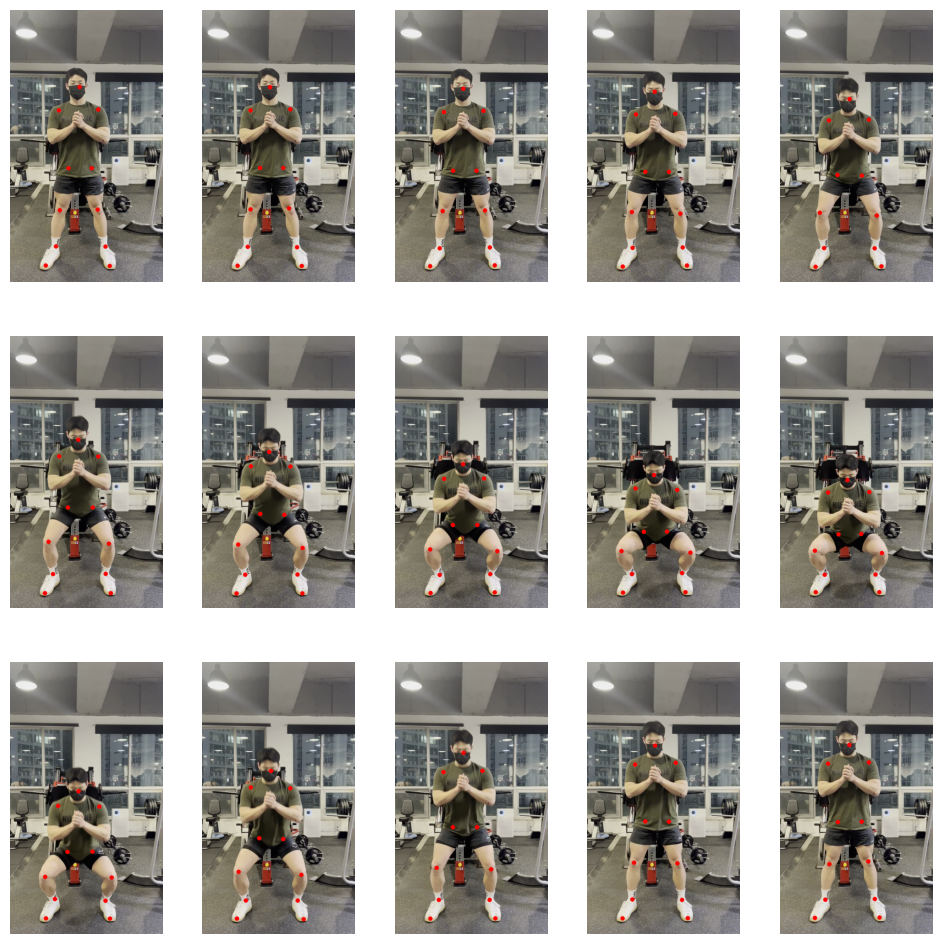

n = 012


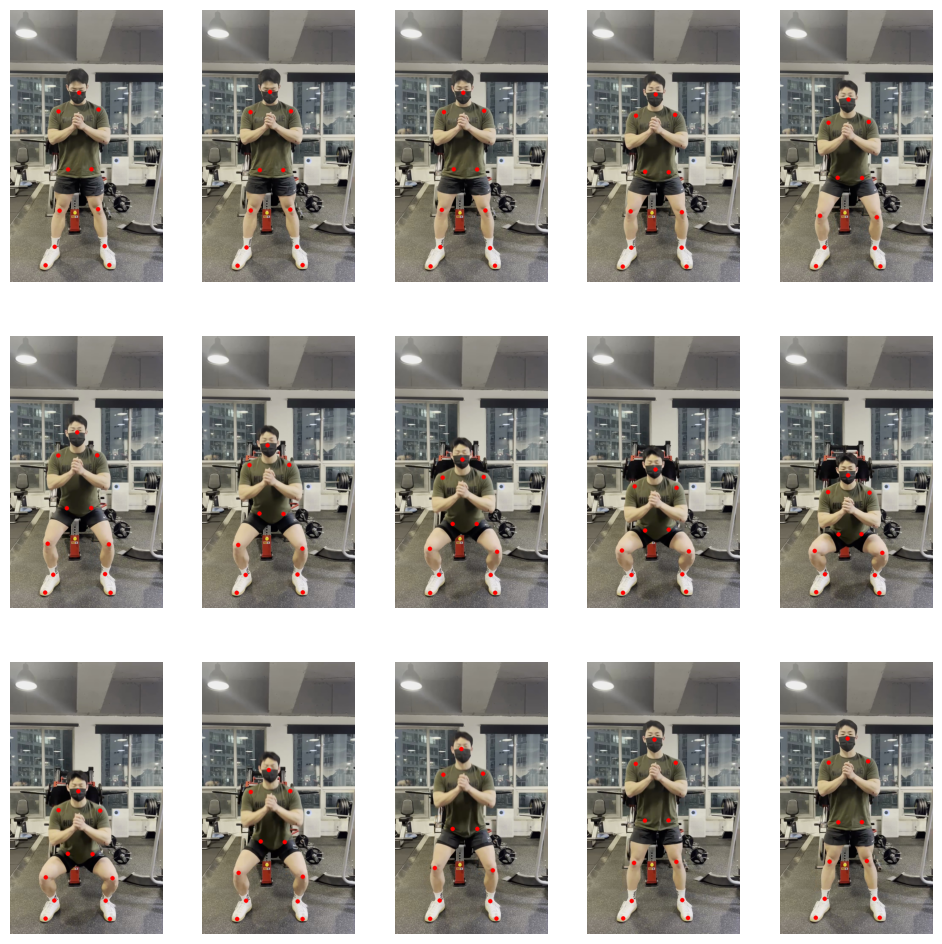

n = 013


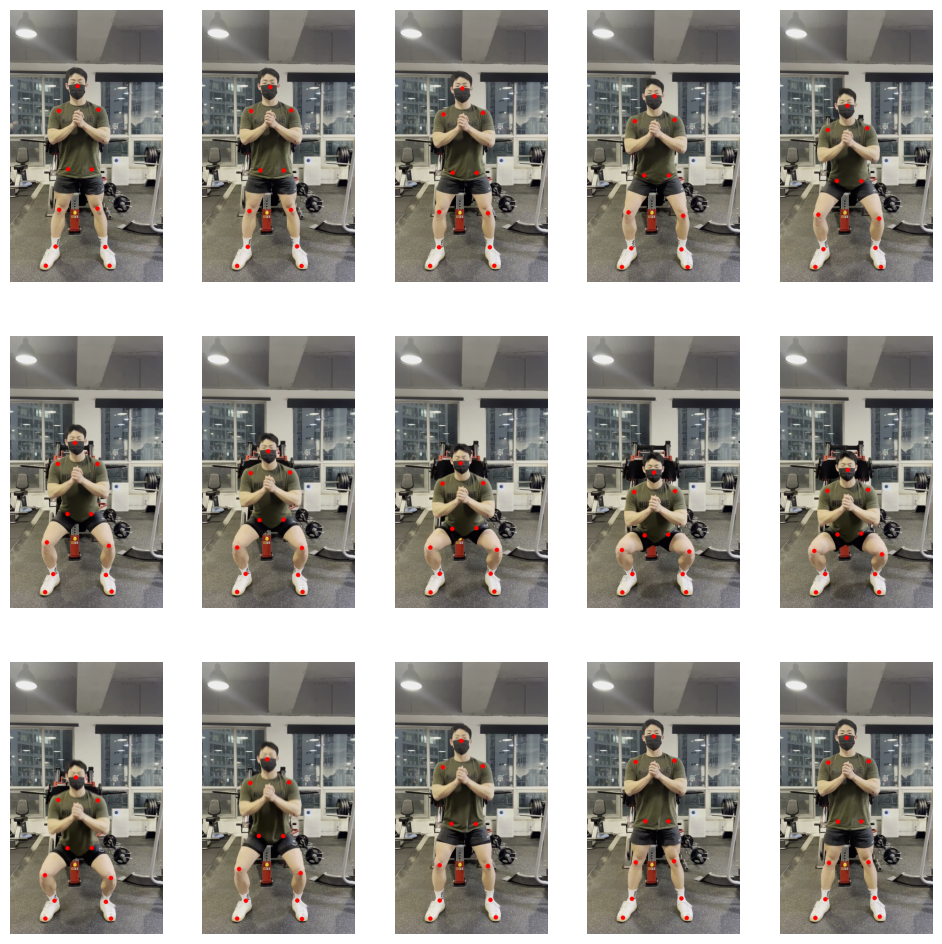

n = 014


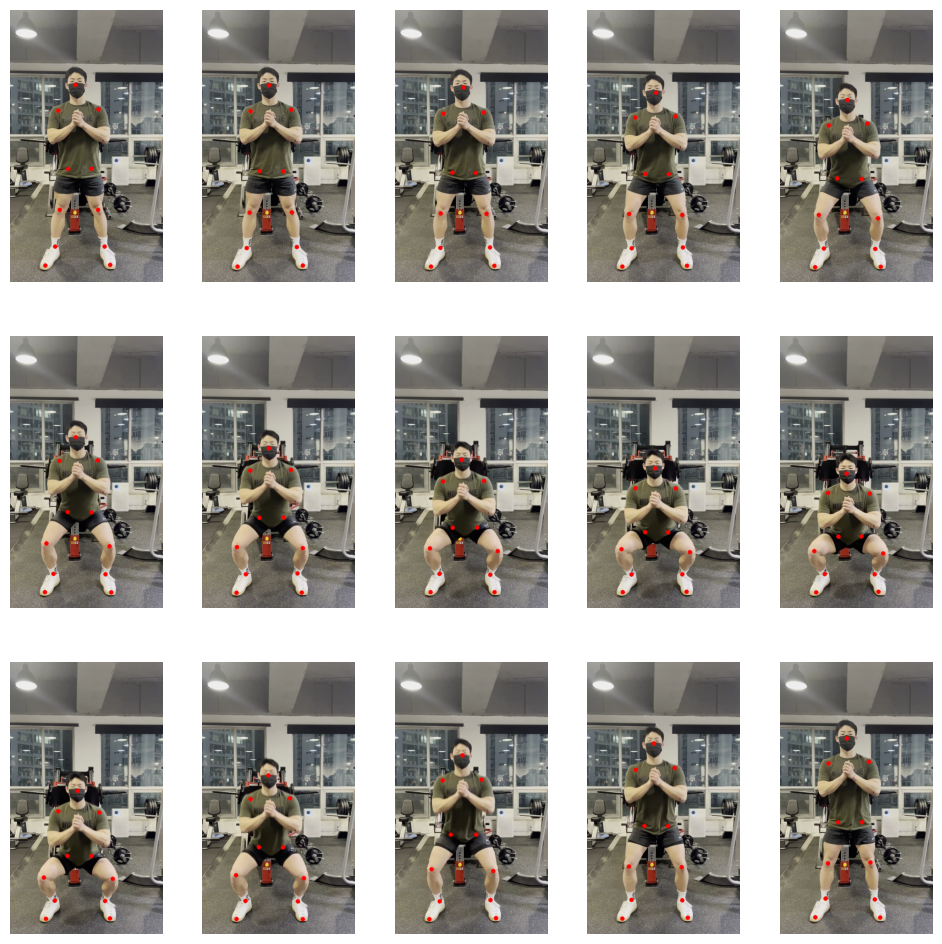

n = 015


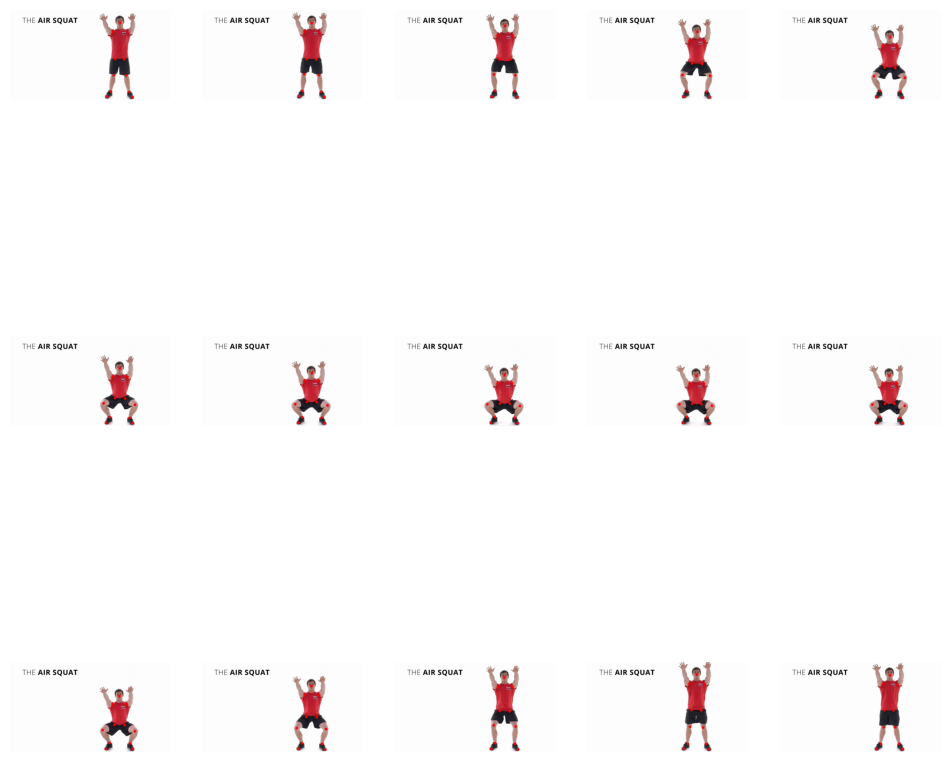

n = 016


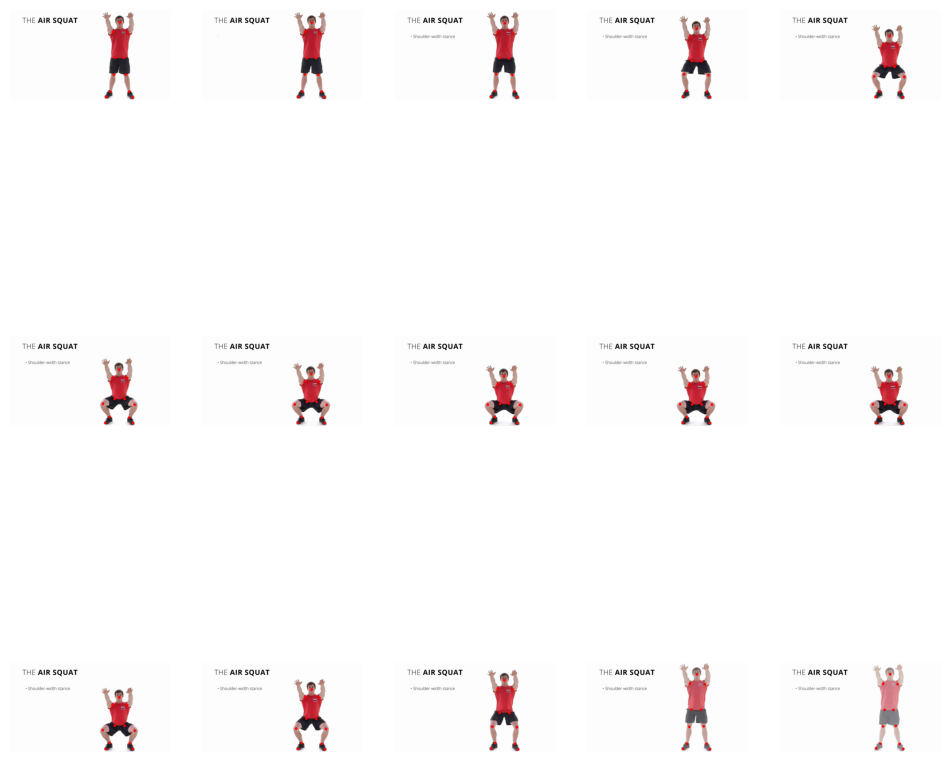

n = 017


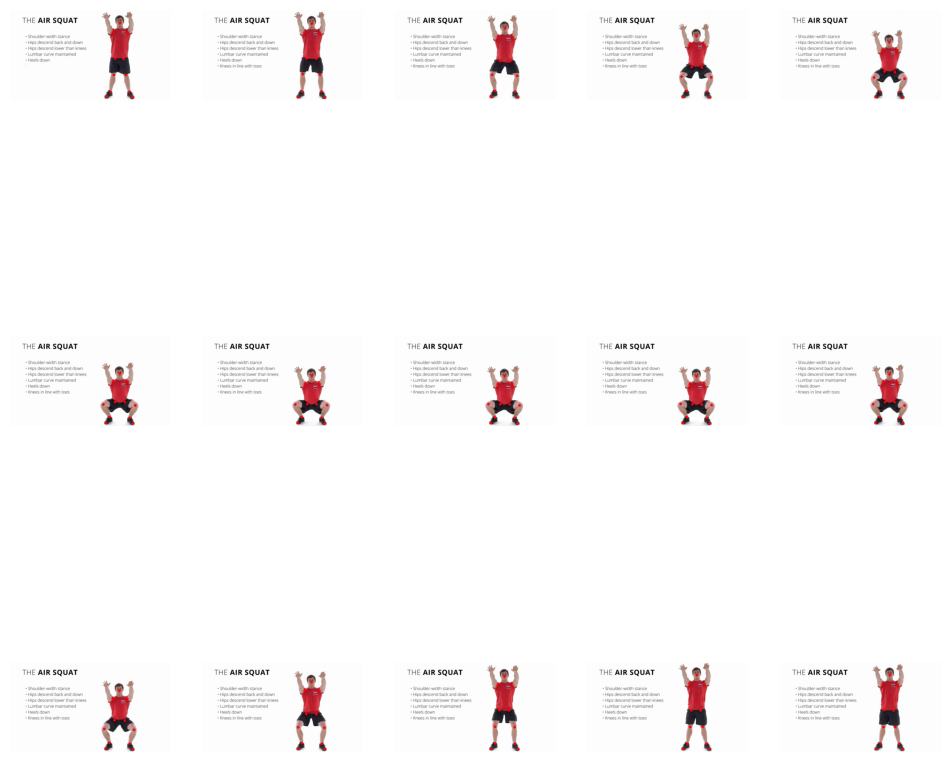

n = 018


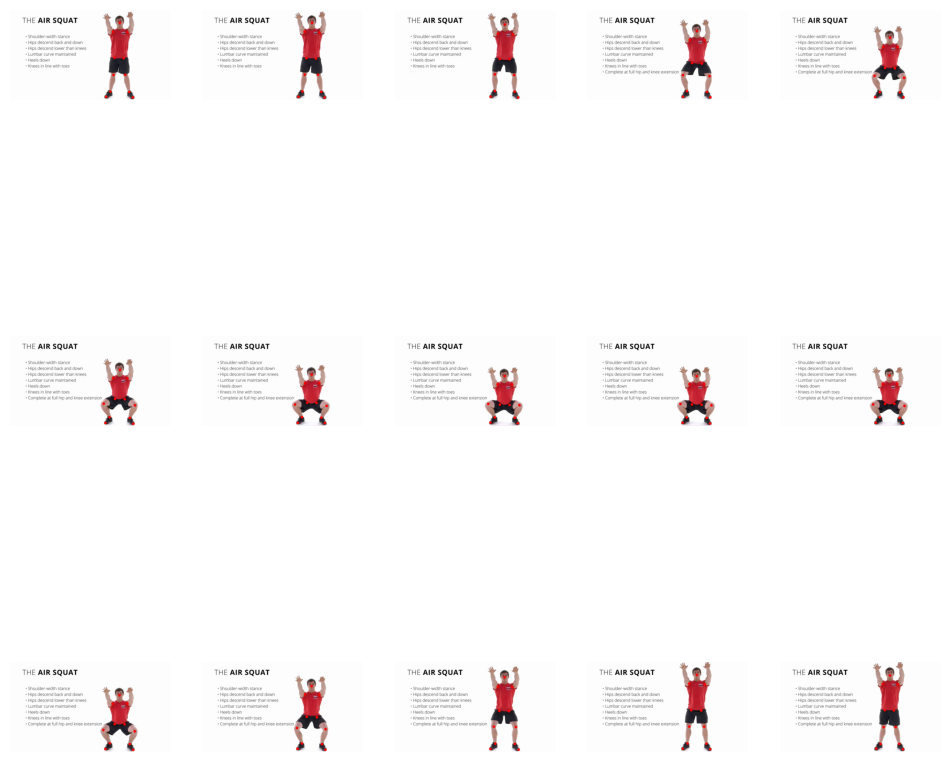

n = 019


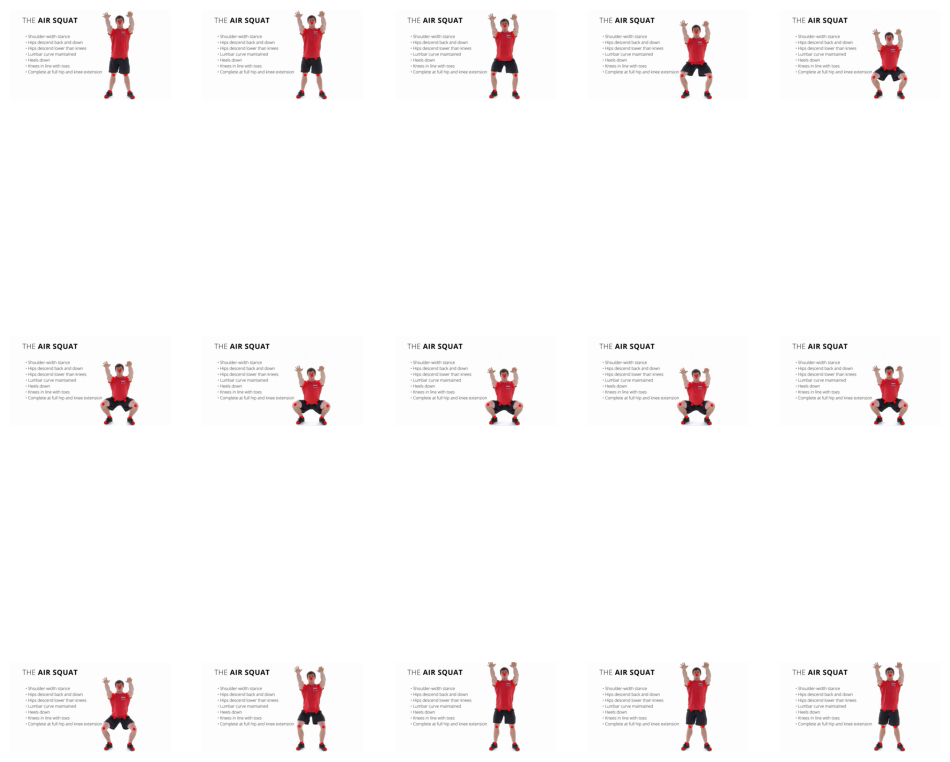

In [66]:
# # n = np.random.randint(0, len(csv_name))
# # n = 20


# for n in range(20):
#     if n < 10:
#         n = f'00{n}'
#     elif n < 100:
#         n = f'0{n}'
#     else:
#         n = f'{n}'
#     print(f'n = {n}')

#     img_list = os.listdir(f'./data/total/2_2_image/{n}/')
#     img_list = sorted(img_list)
#     fig, ax = plt.subplots(3, 5, figsize = (12,12))

#     for i in range(globals()[f'df{n}'].shape[0]):

#         background = cv2.imread(f'./data/total/2_2_image/{n}/' + img_list[i])
#         background = cv2.cvtColor(background, cv2.COLOR_BGR2RGB)
#         temp = globals()[f'df{n}'].iloc[i]
#         temp = np.array(temp)
#         temp = temp.reshape(11, 2)

#         for j in temp:
#             cx = int(j[0]*background.shape[1])
#             cy = int(j[1]*background.shape[0])
#             cv2.circle(background, (cx, cy), radius=5, color=(255,0,0), thickness=10)

#         plt.subplot(3, 5, i + 1)
#         plt.imshow(background)
#         plt.axis('off')
    
#     plt.show()

n = 026


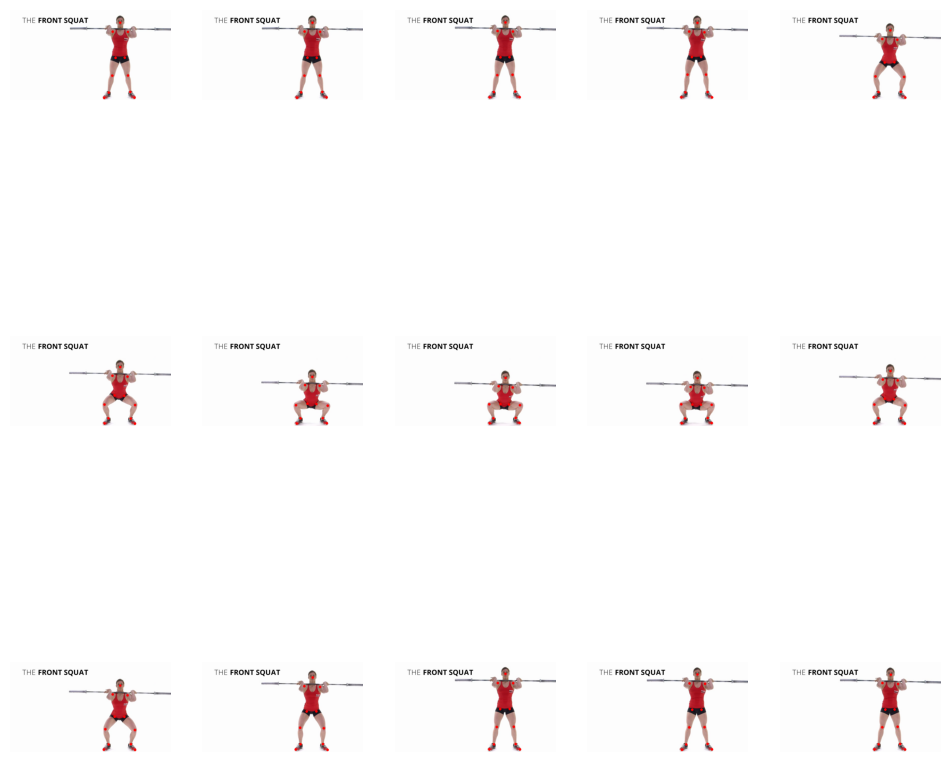

n = 027


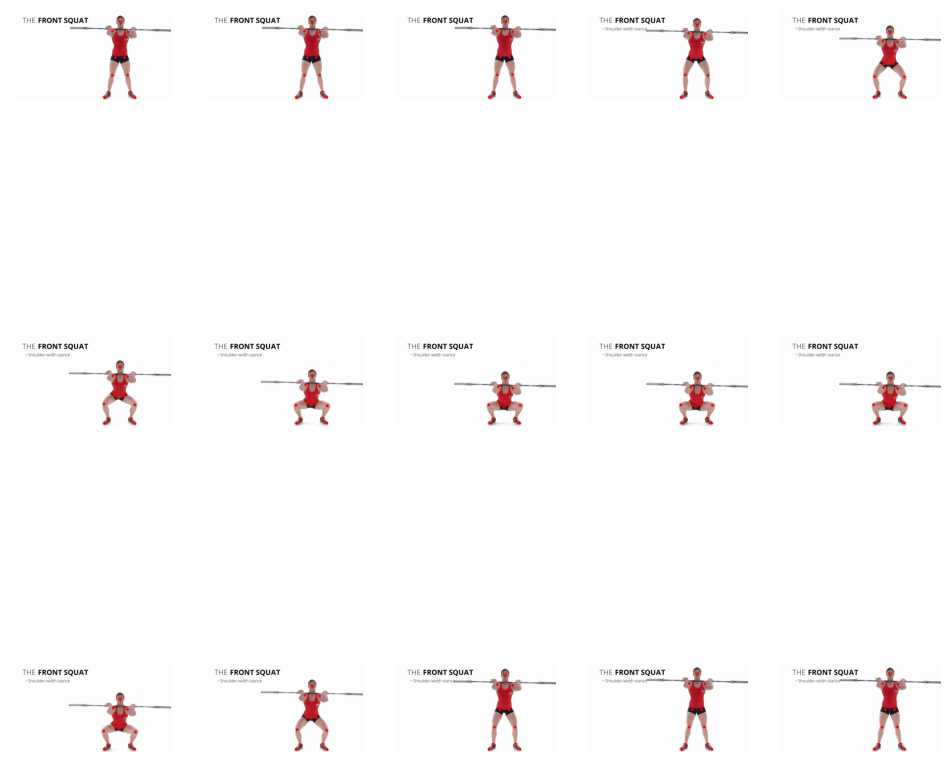

n = 028


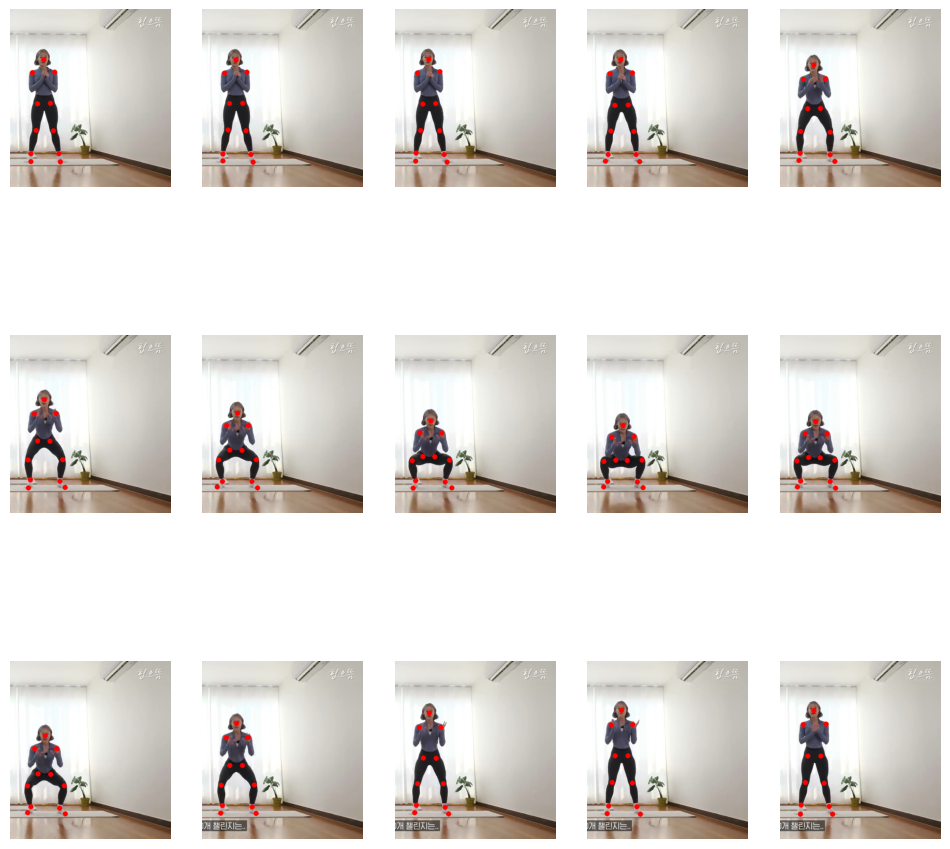

n = 029


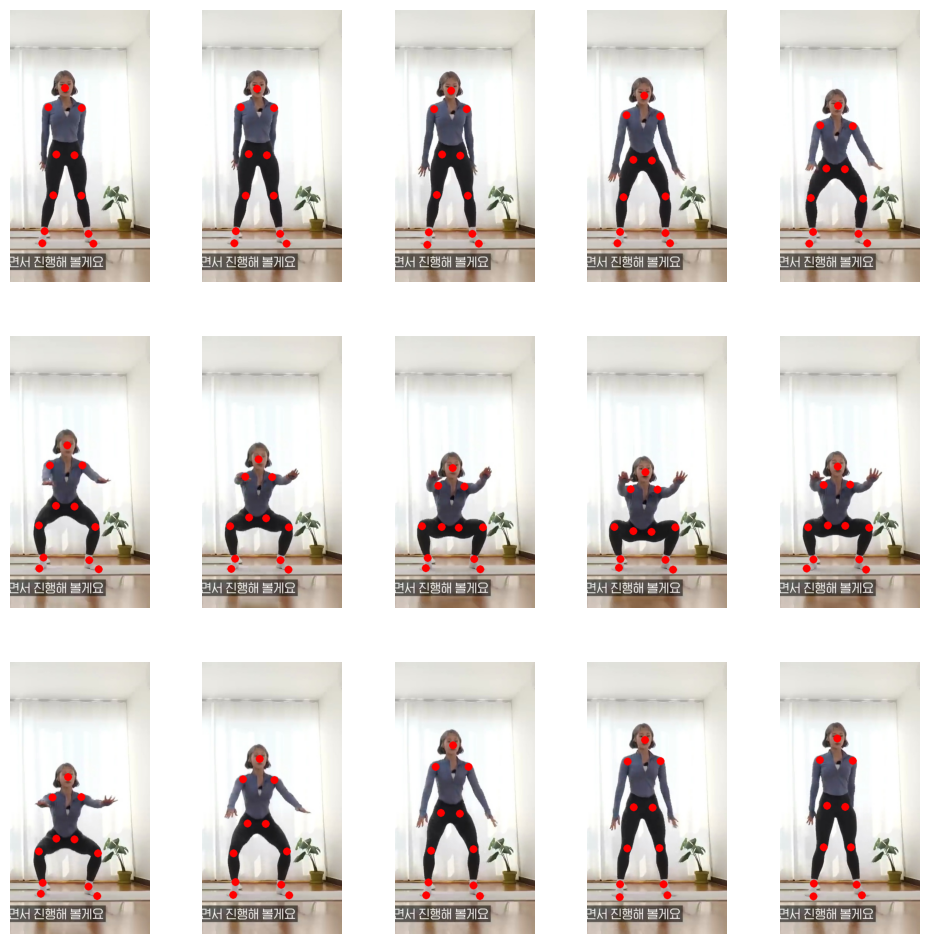

n = 030


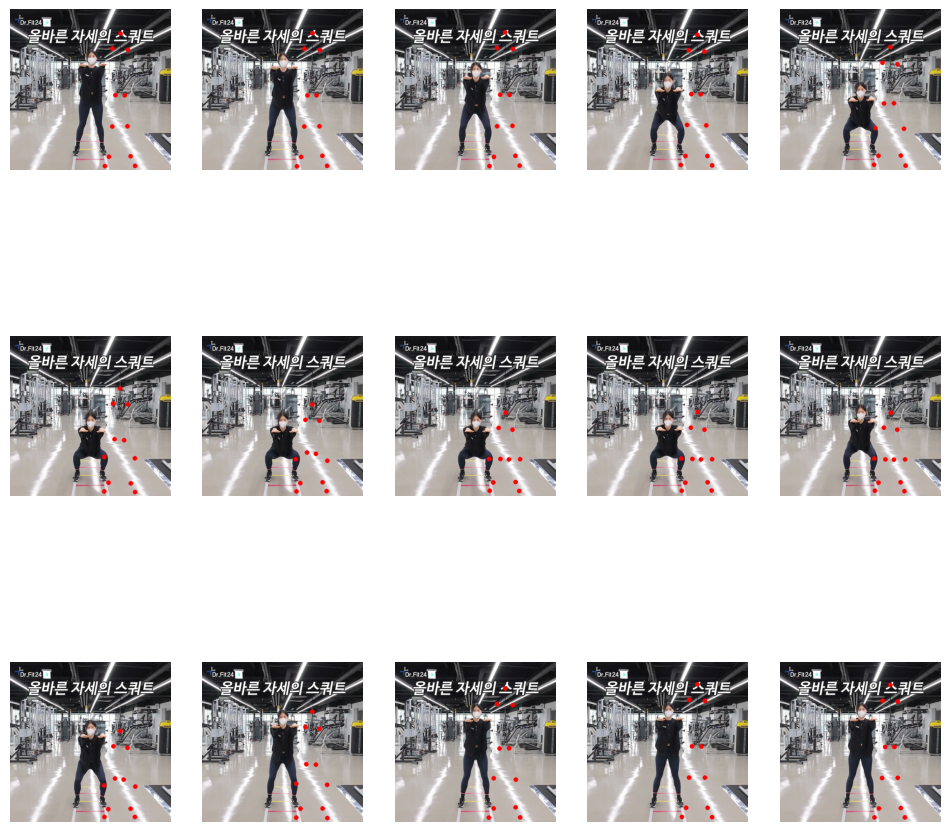

n = 031


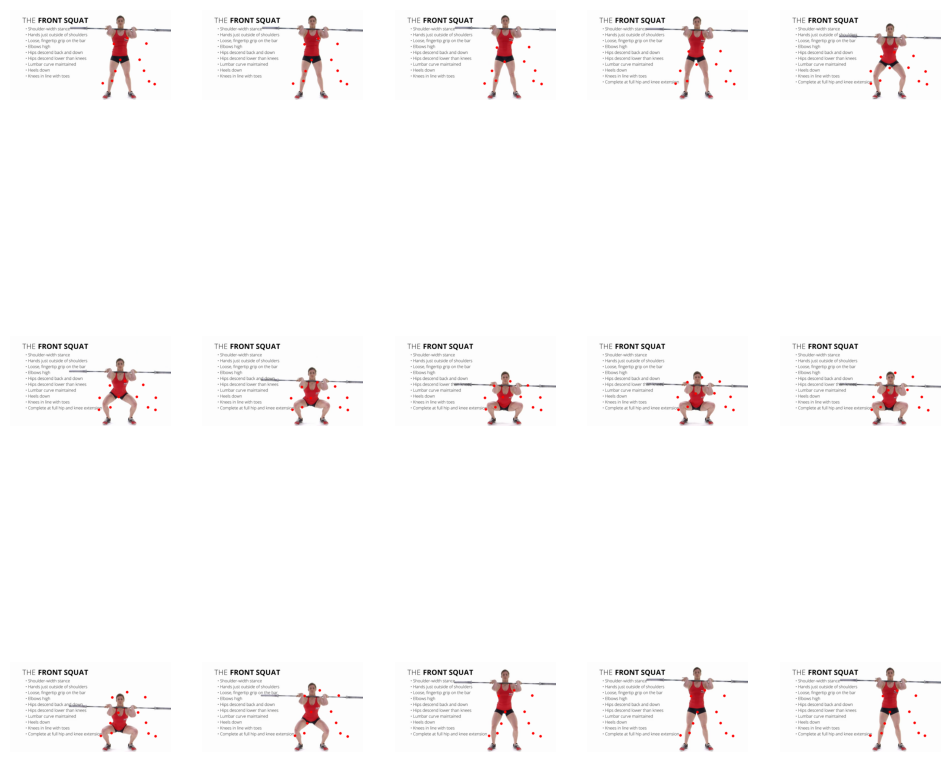

n = 032


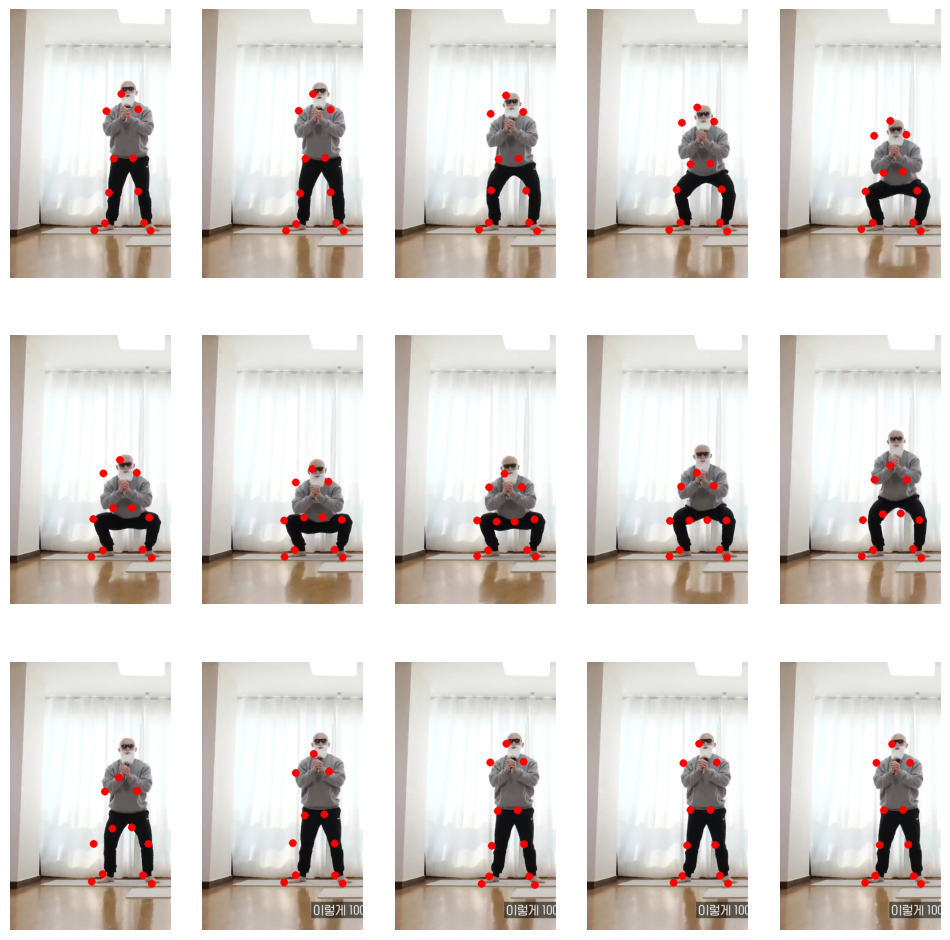

n = 033


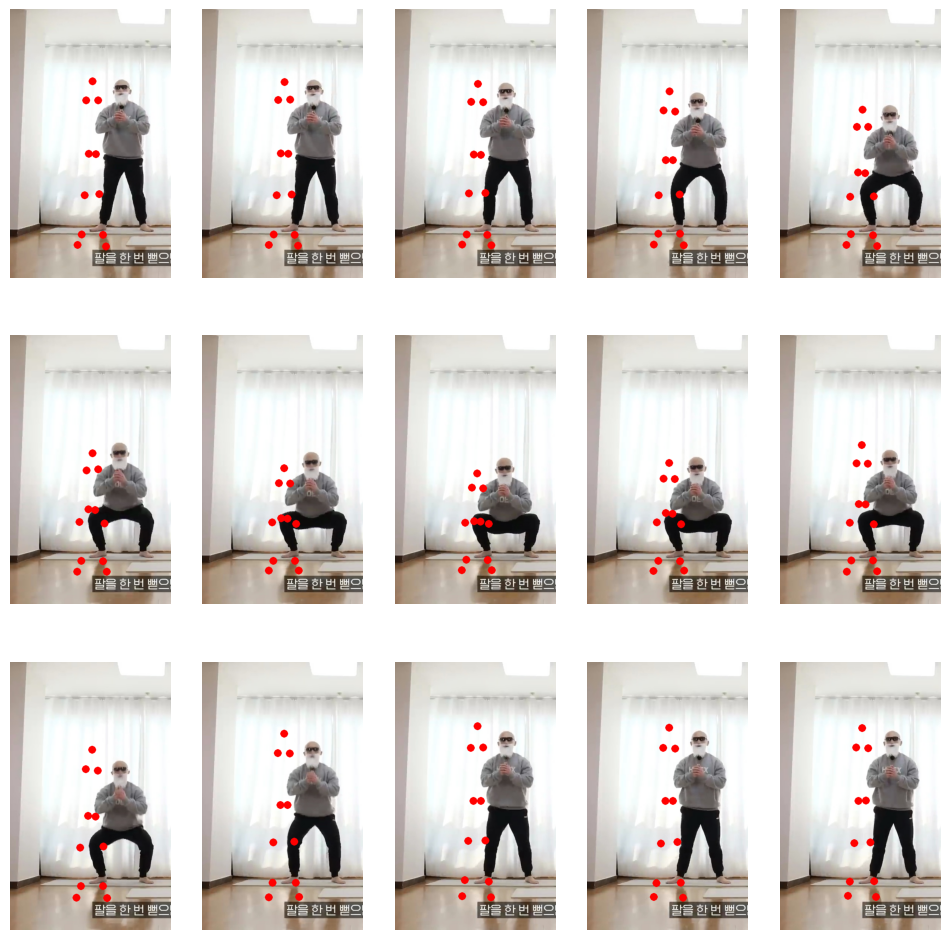

n = 034


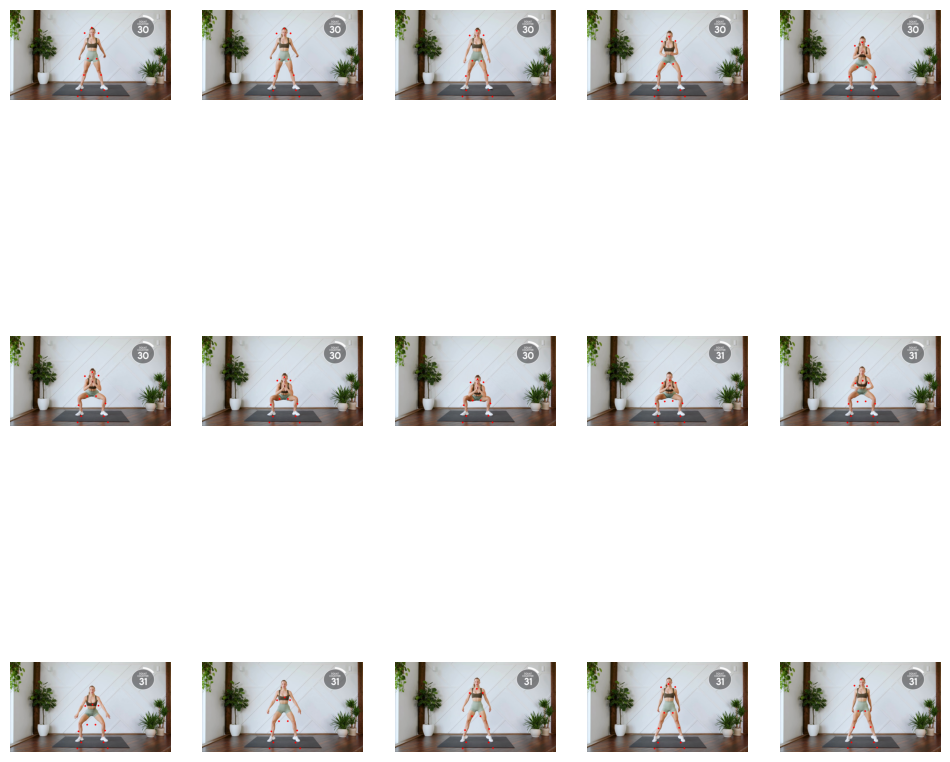

n = 035


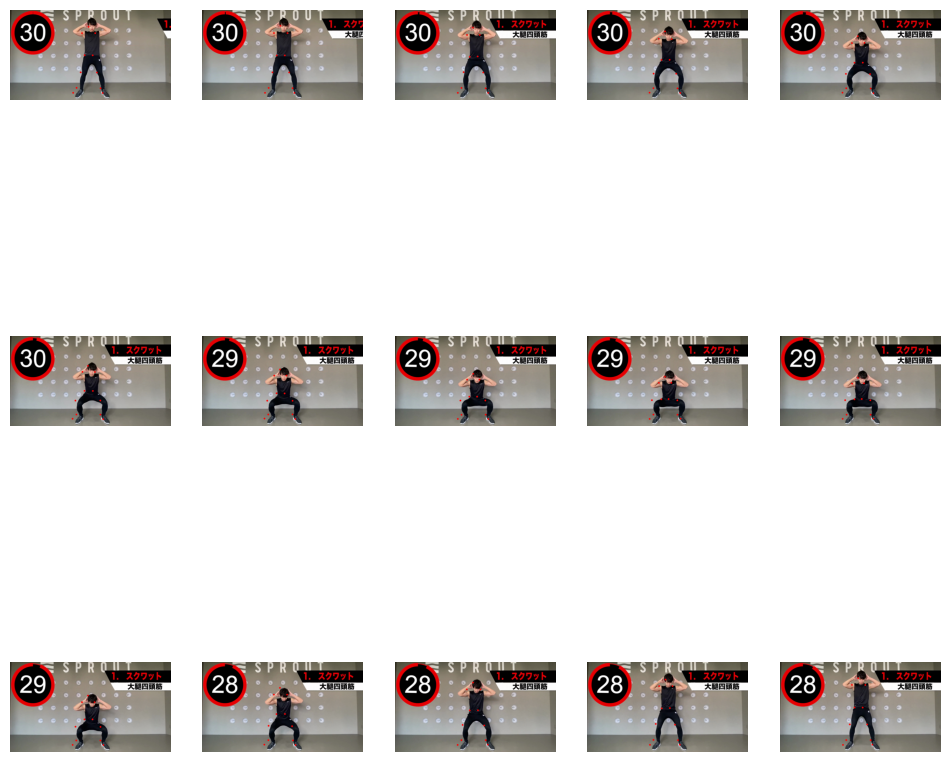

n = 036


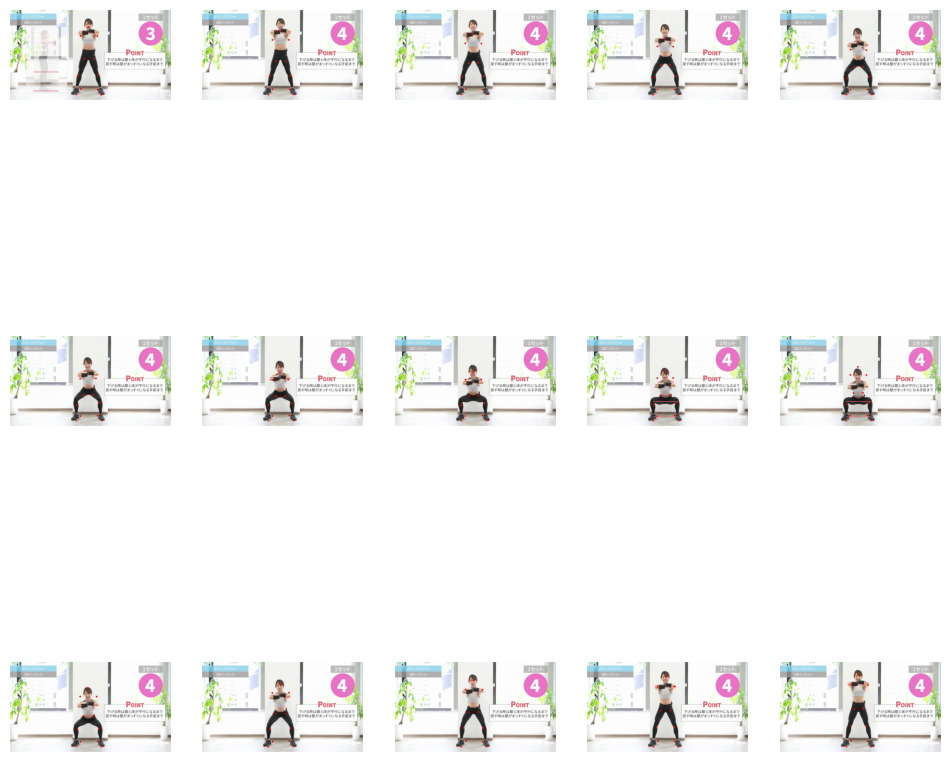

n = 037


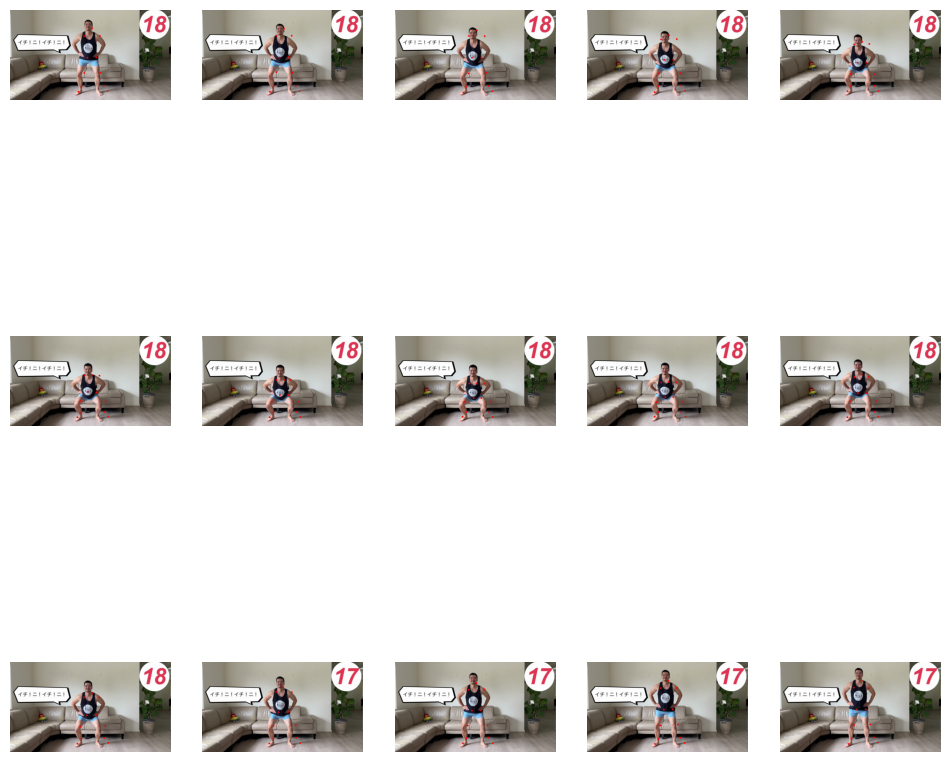

n = 038


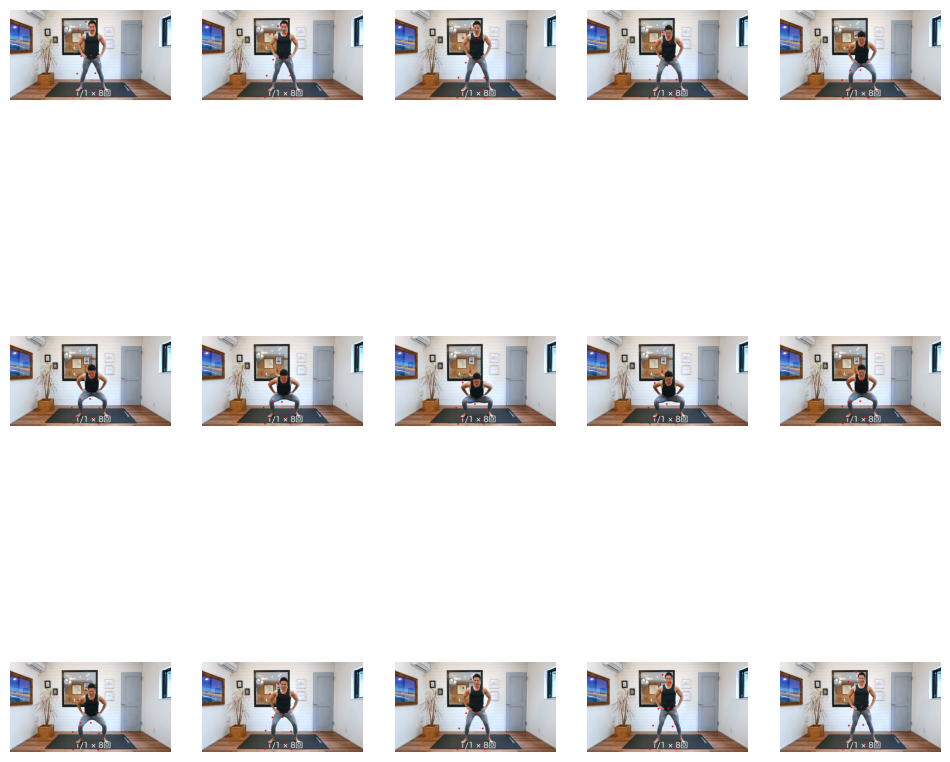

n = 039


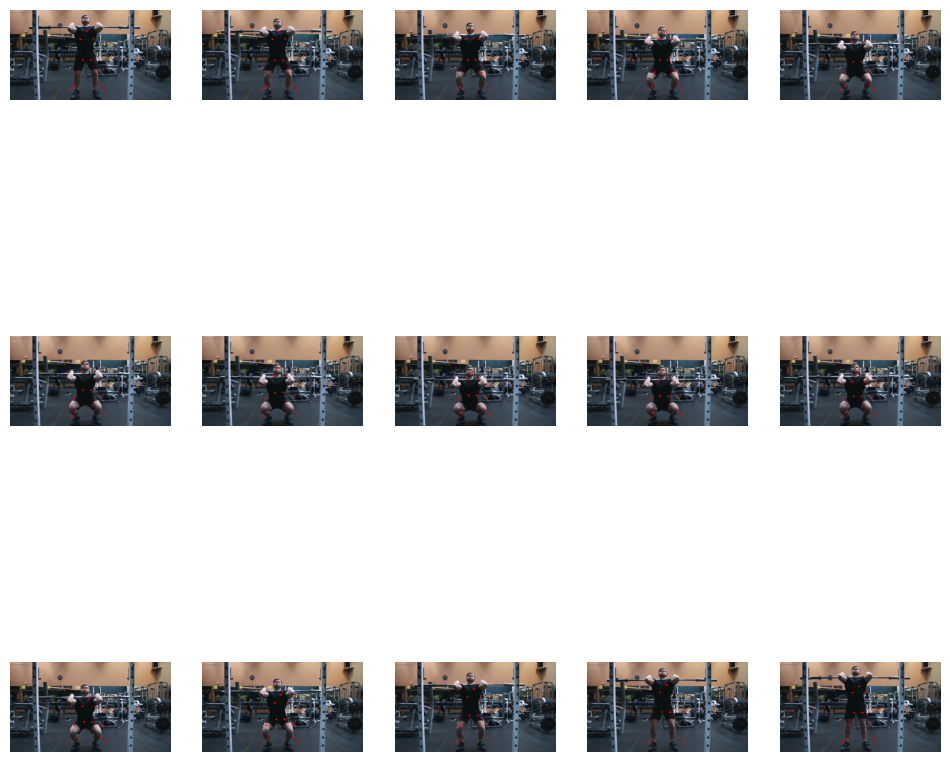

n = 040


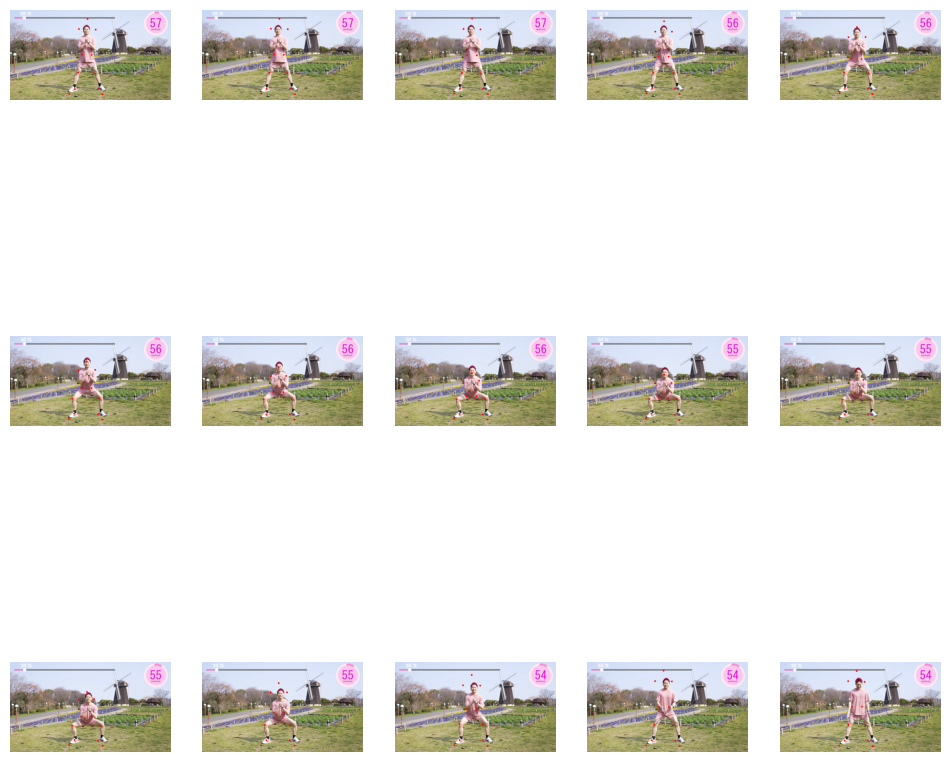

n = 041


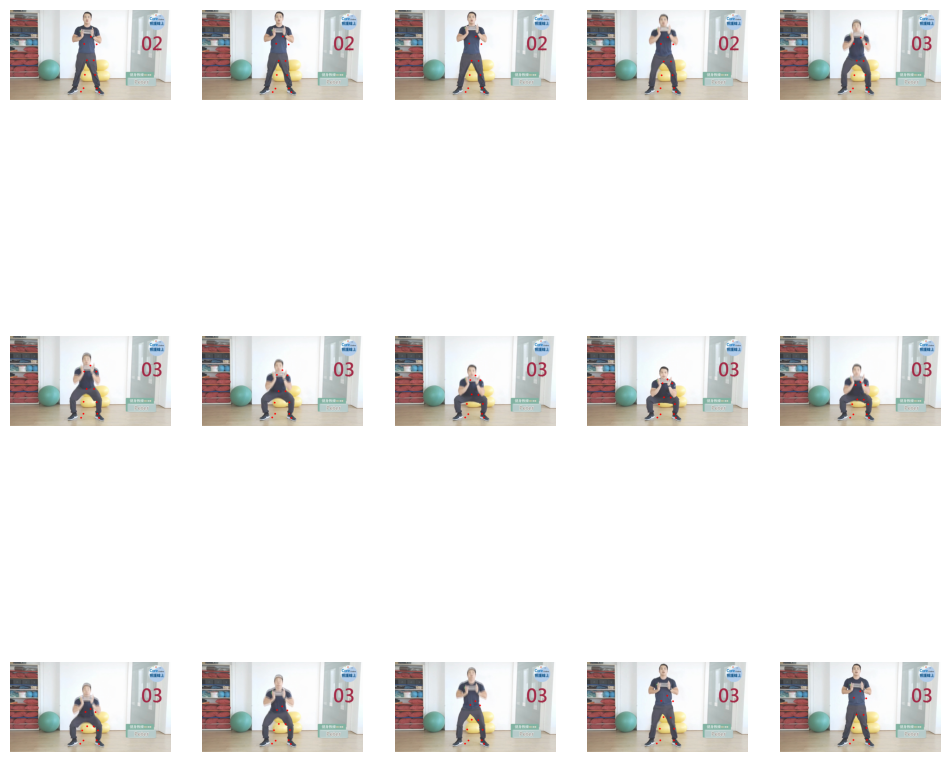

n = 042


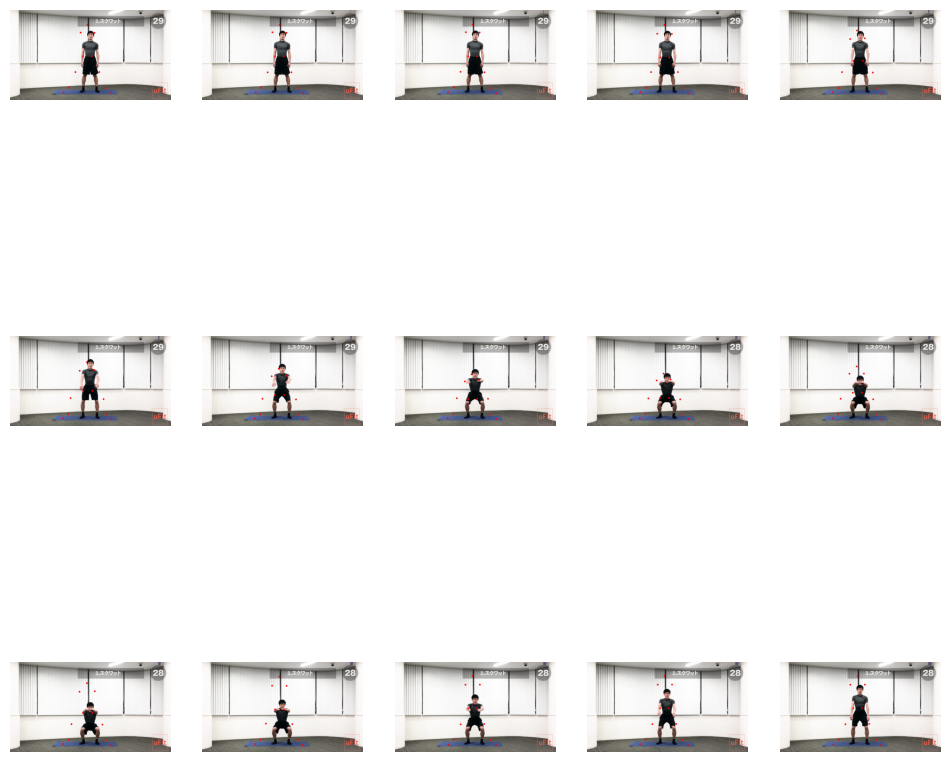

n = 043


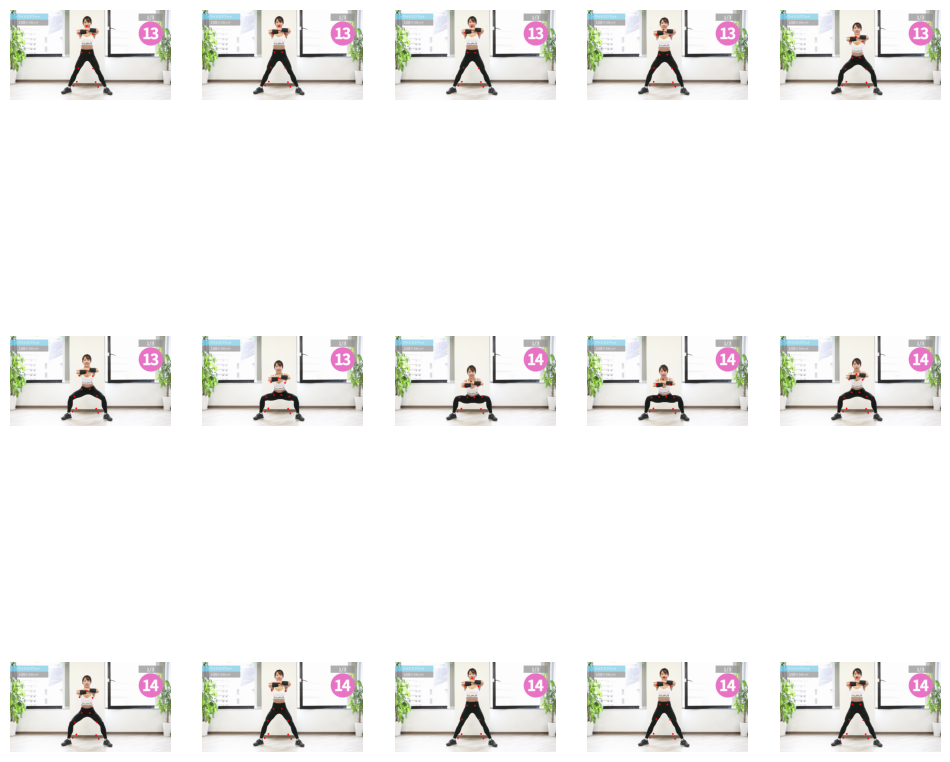

n = 044


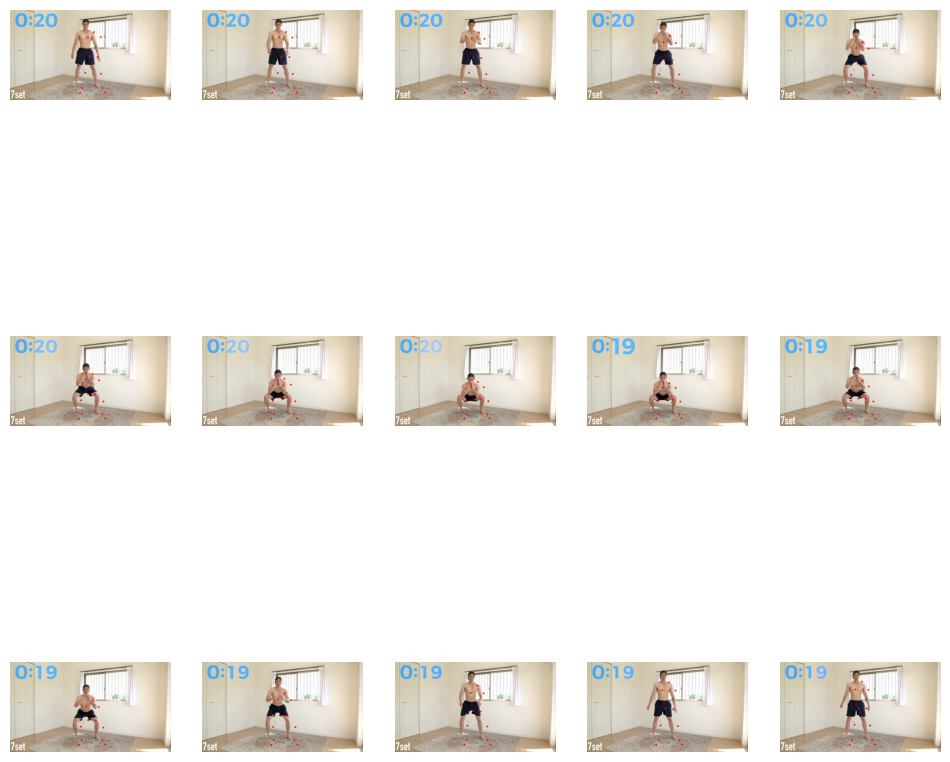

n = 045


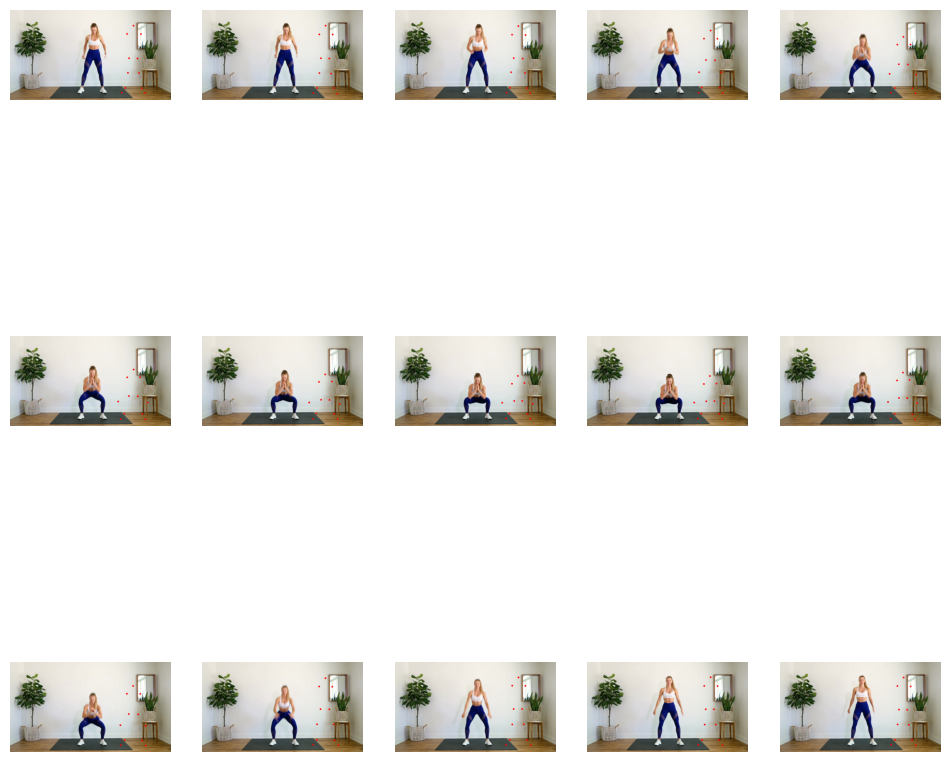

n = 046


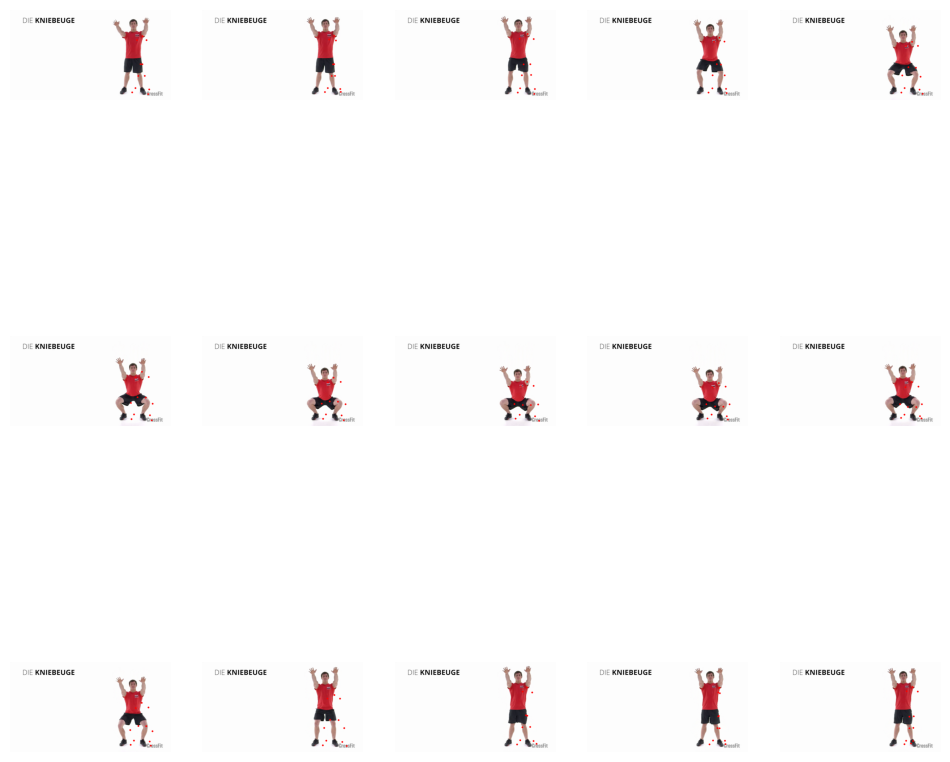

n = 047


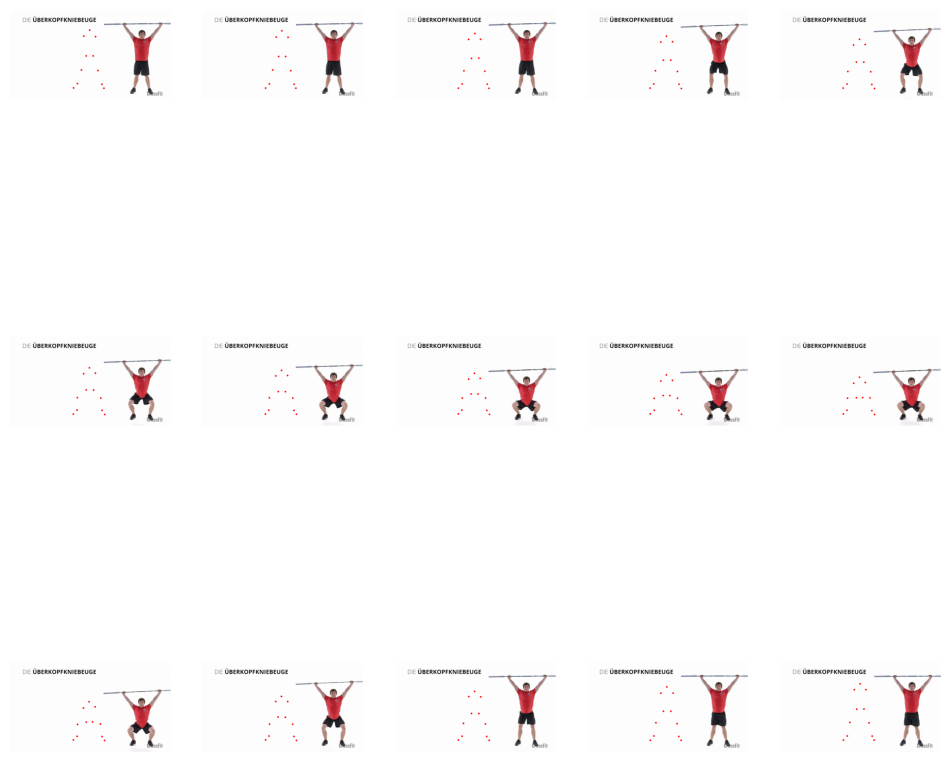

n = 048


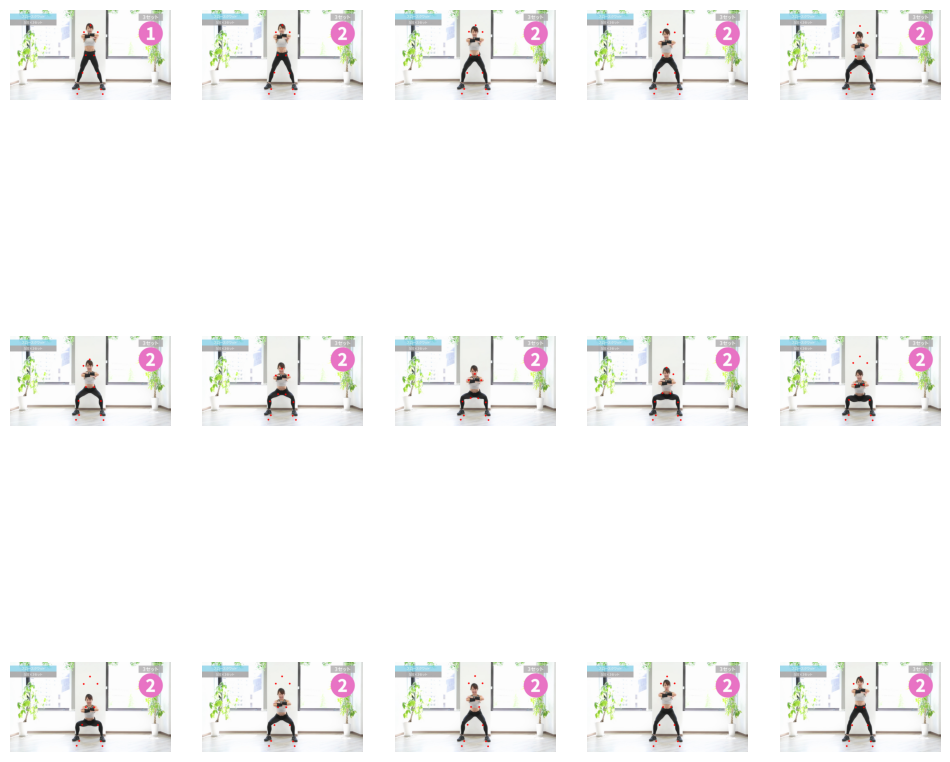

n = 049


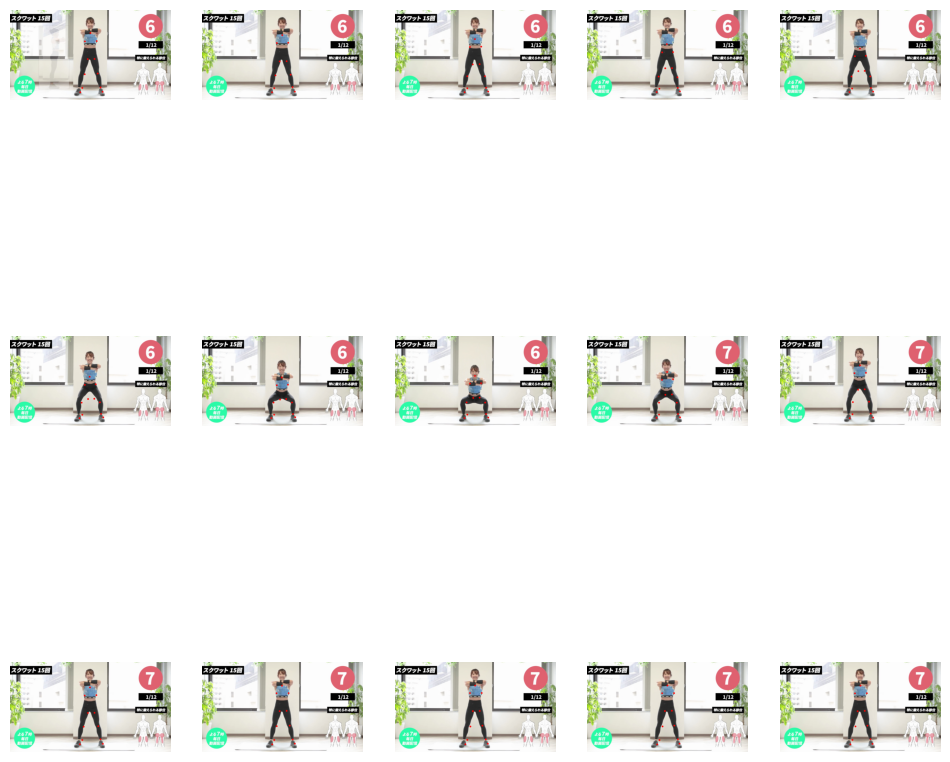

n = 050


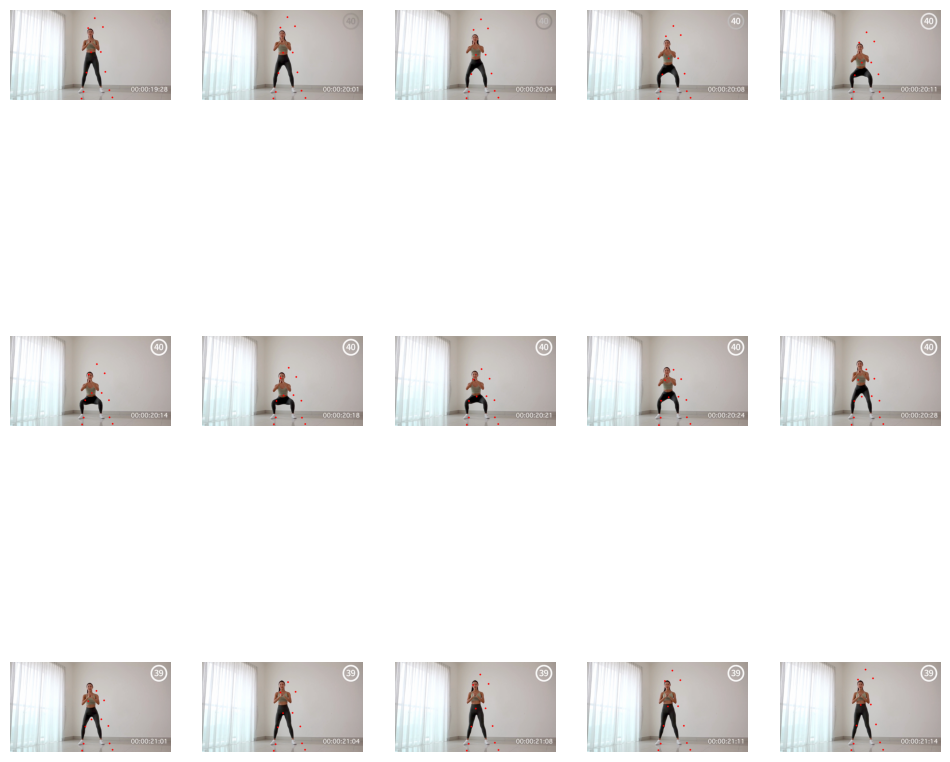

n = 051


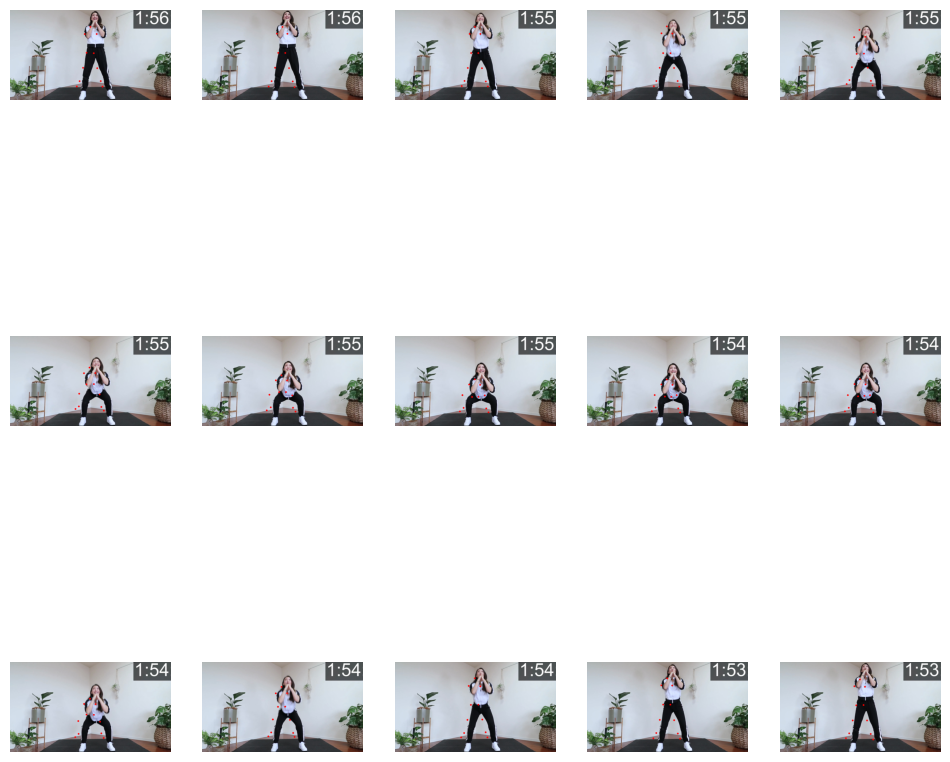

n = 052


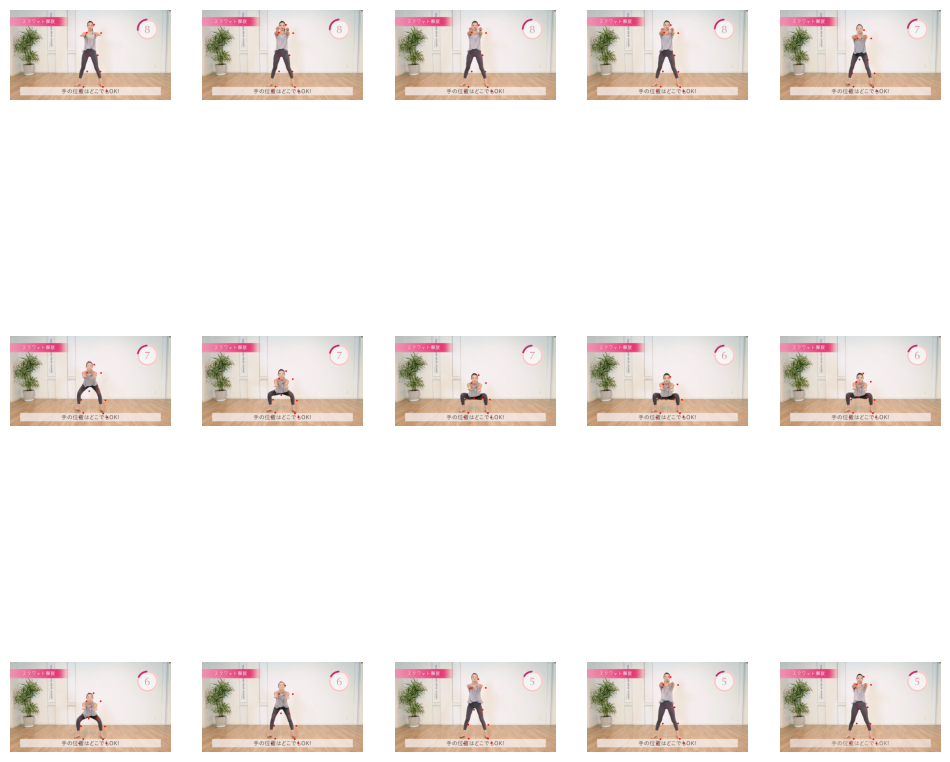

n = 053


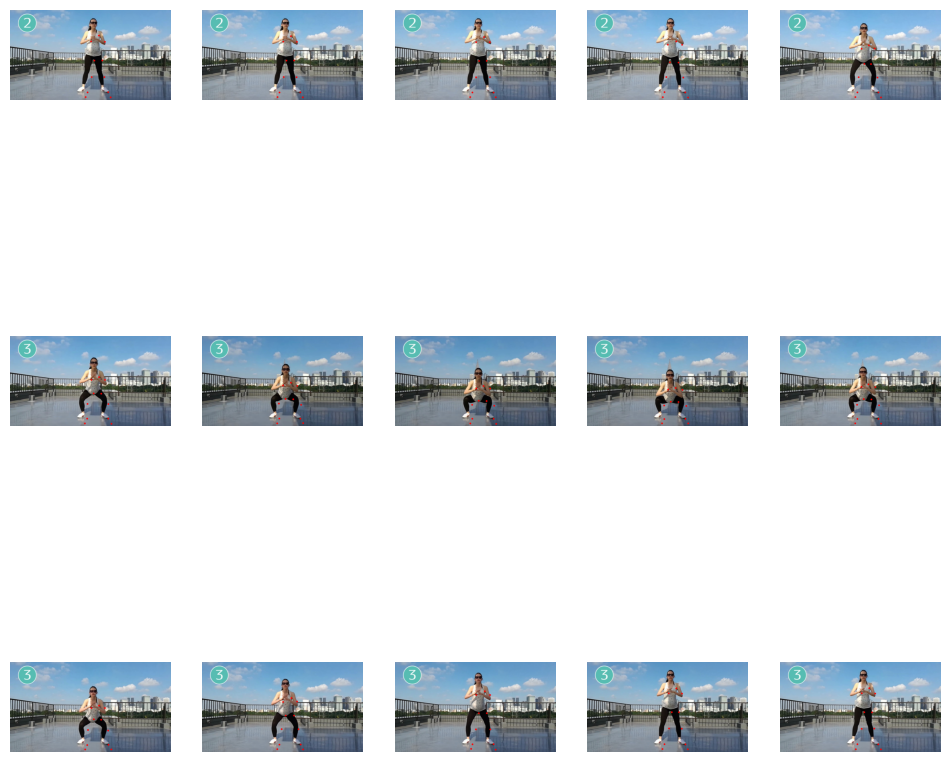

n = 054


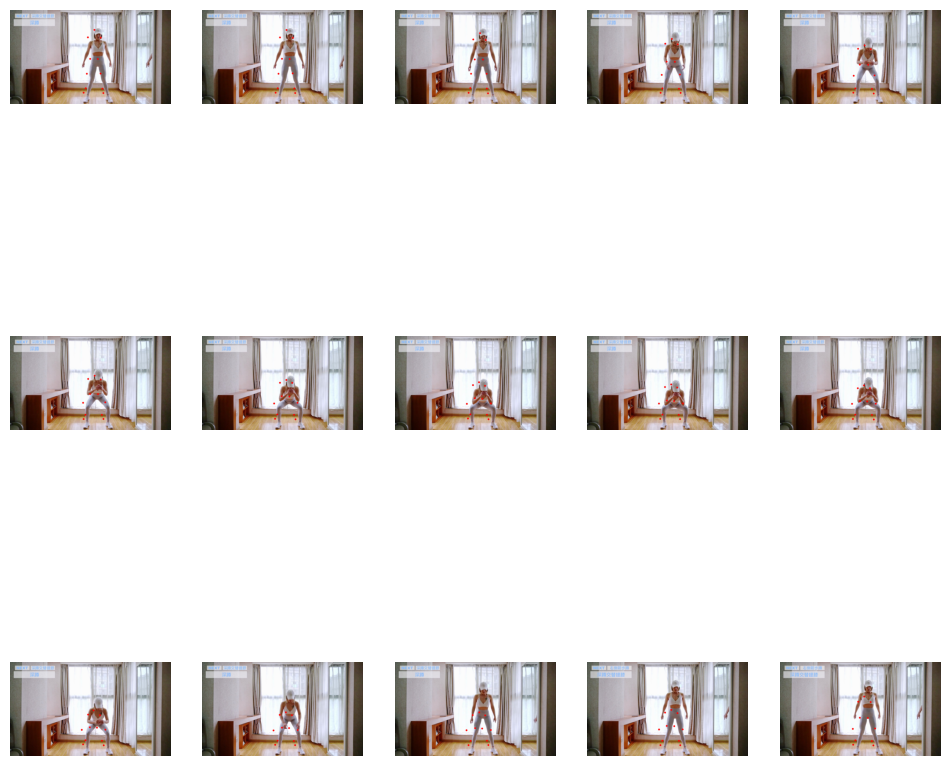

n = 055


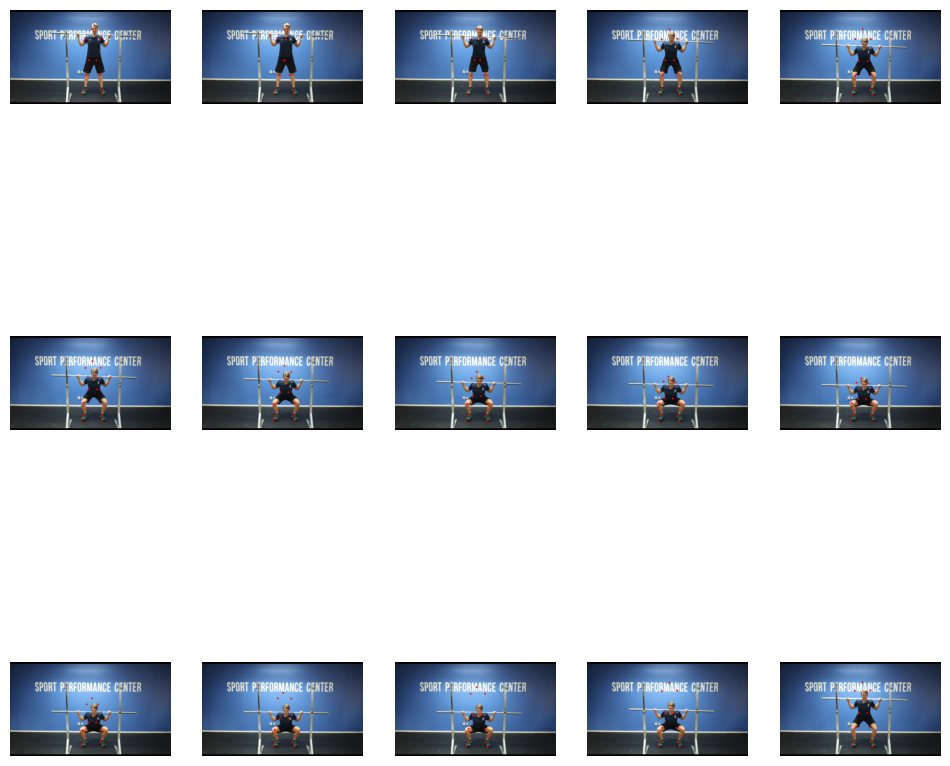

n = 056


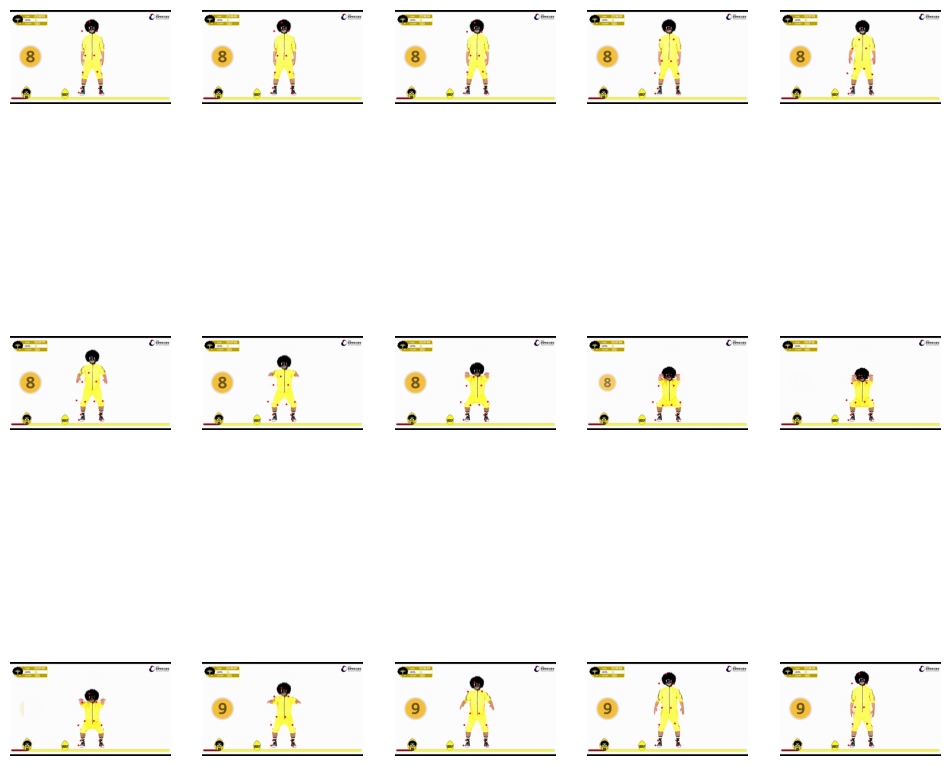

n = 057


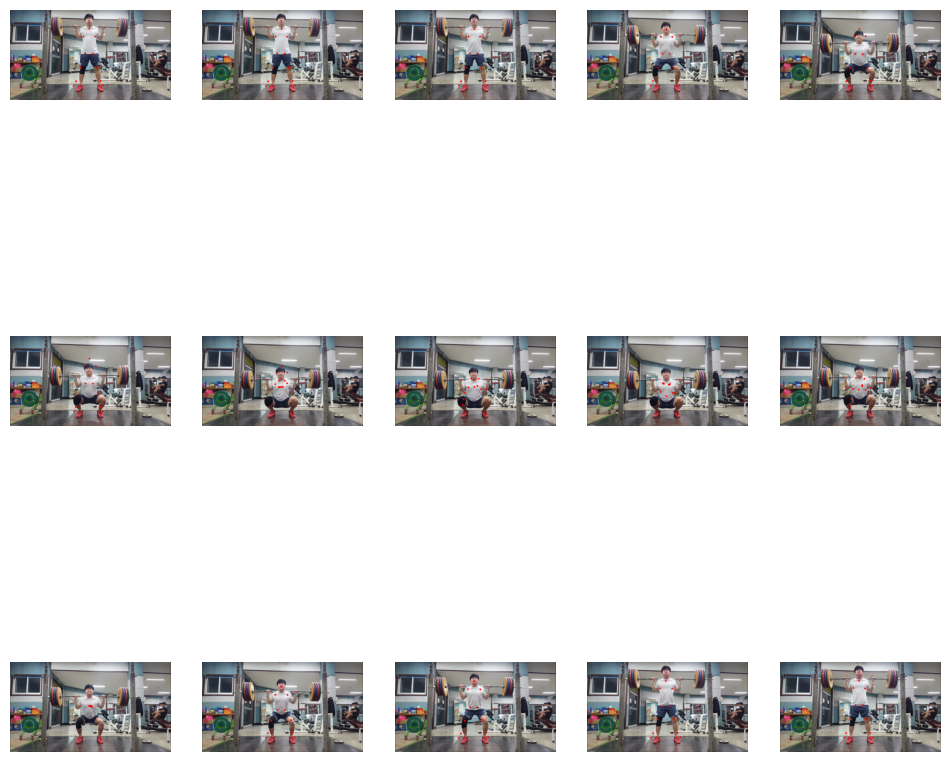

n = 058


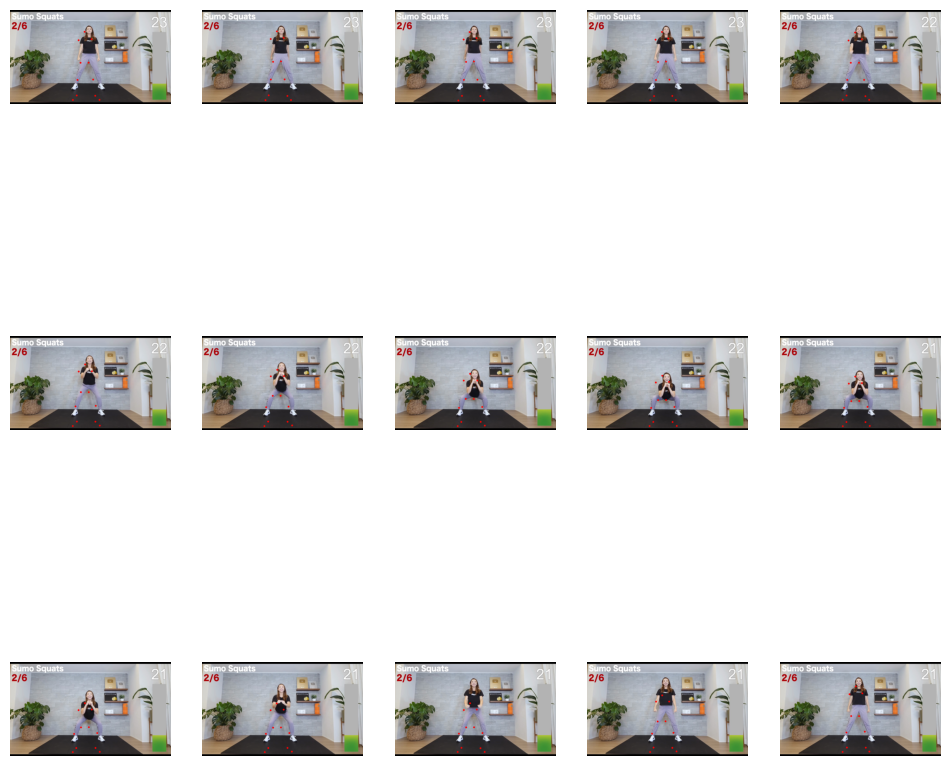

n = 059


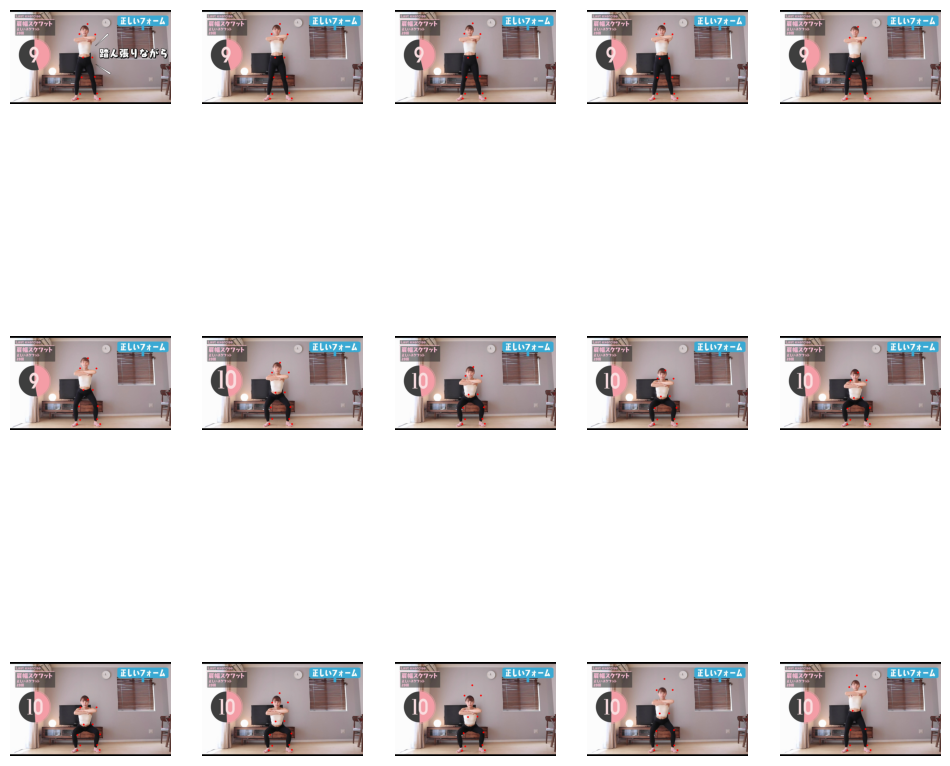

n = 060


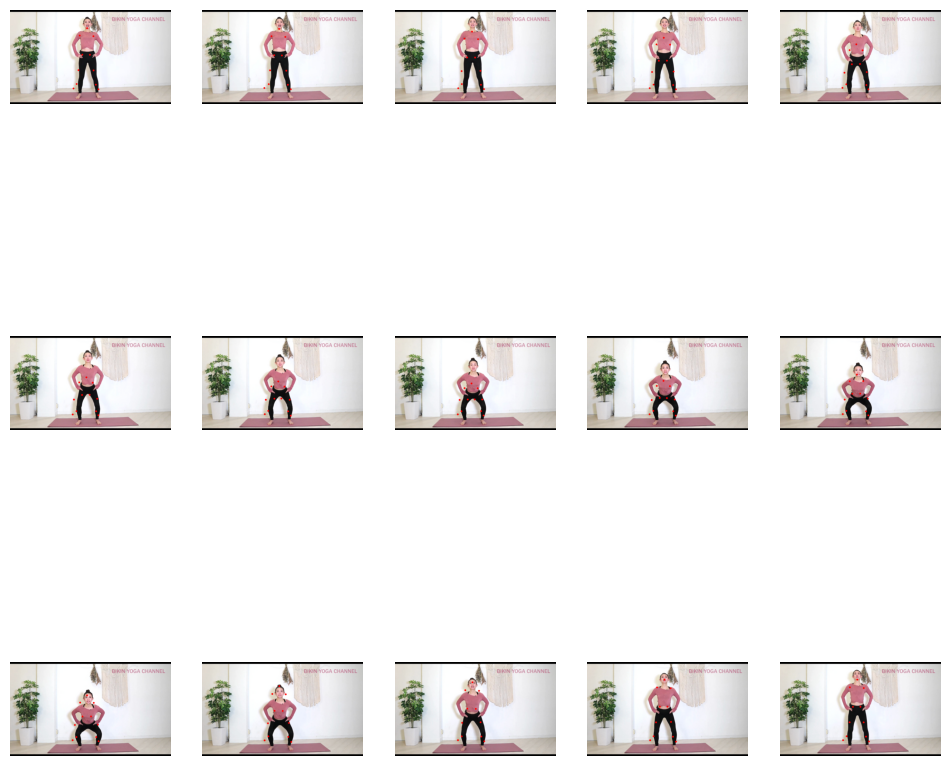

n = 061


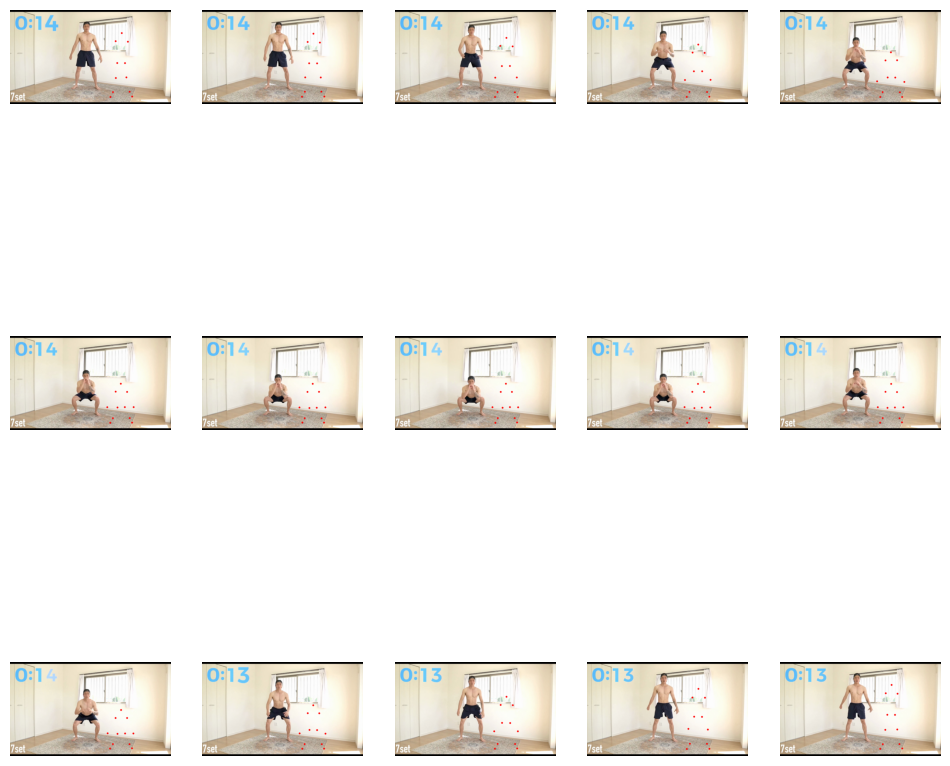

n = 062


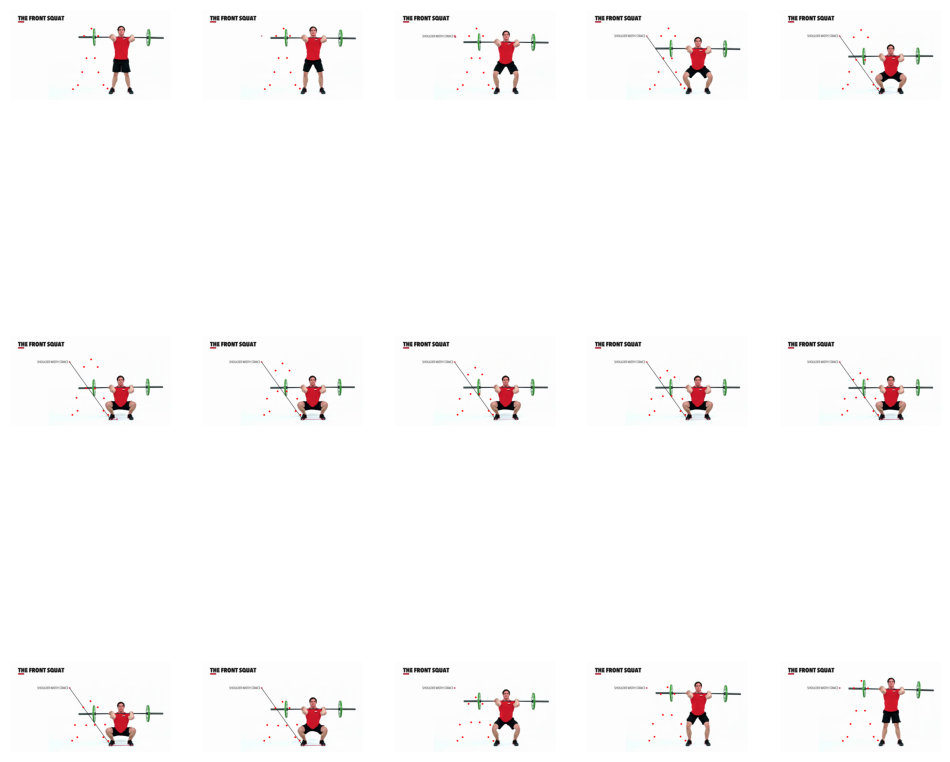

n = 063


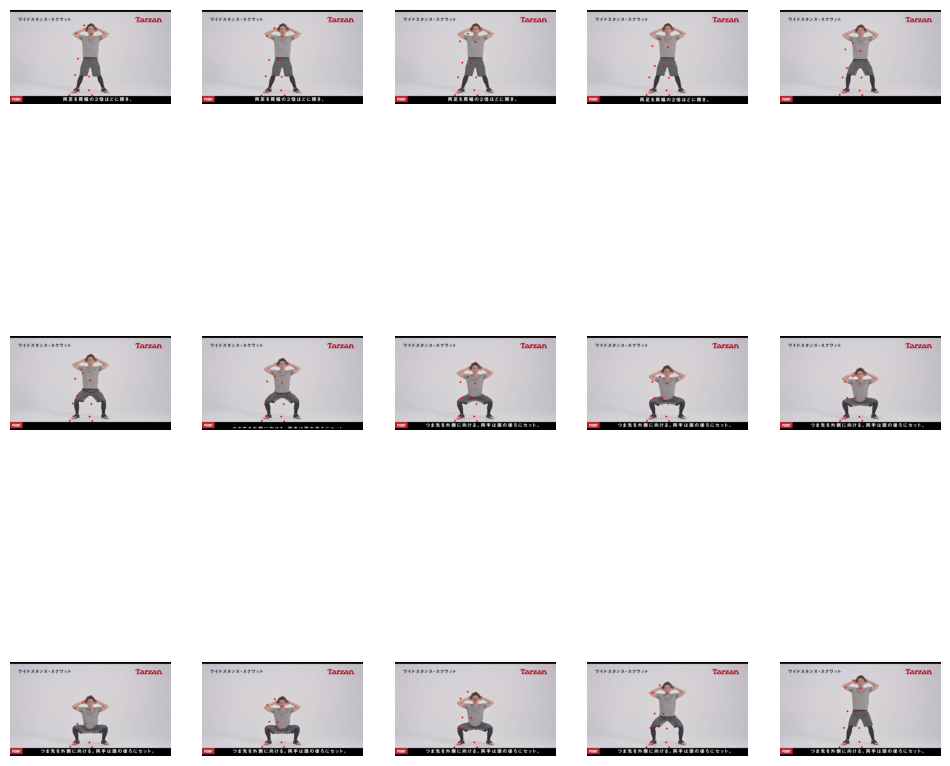

n = 064


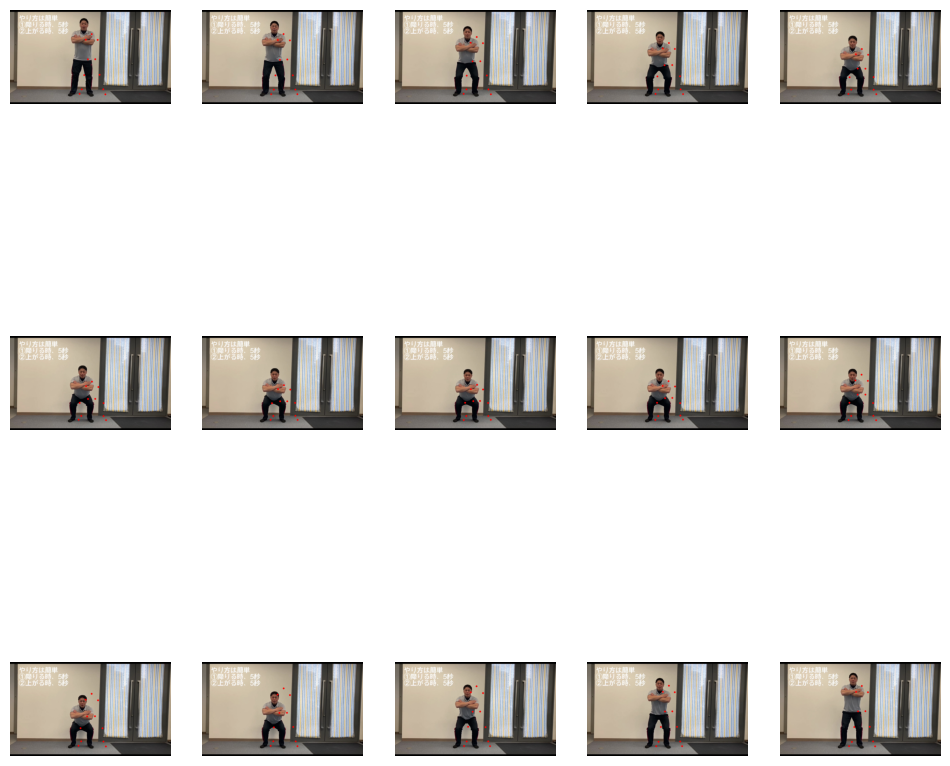

n = 065


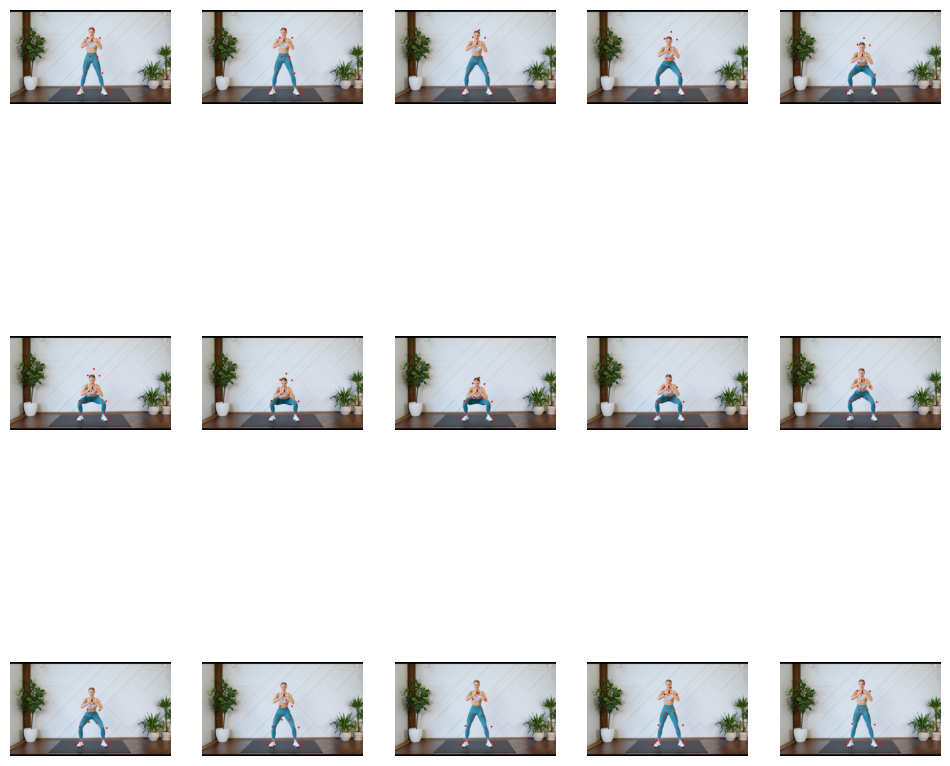

n = 066


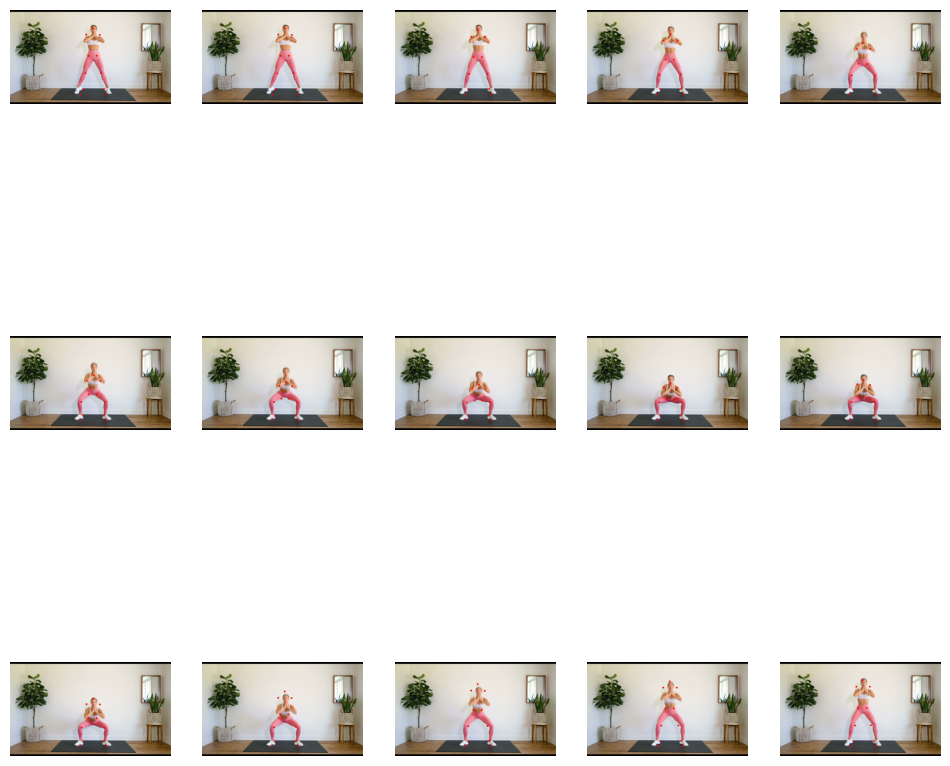

n = 067


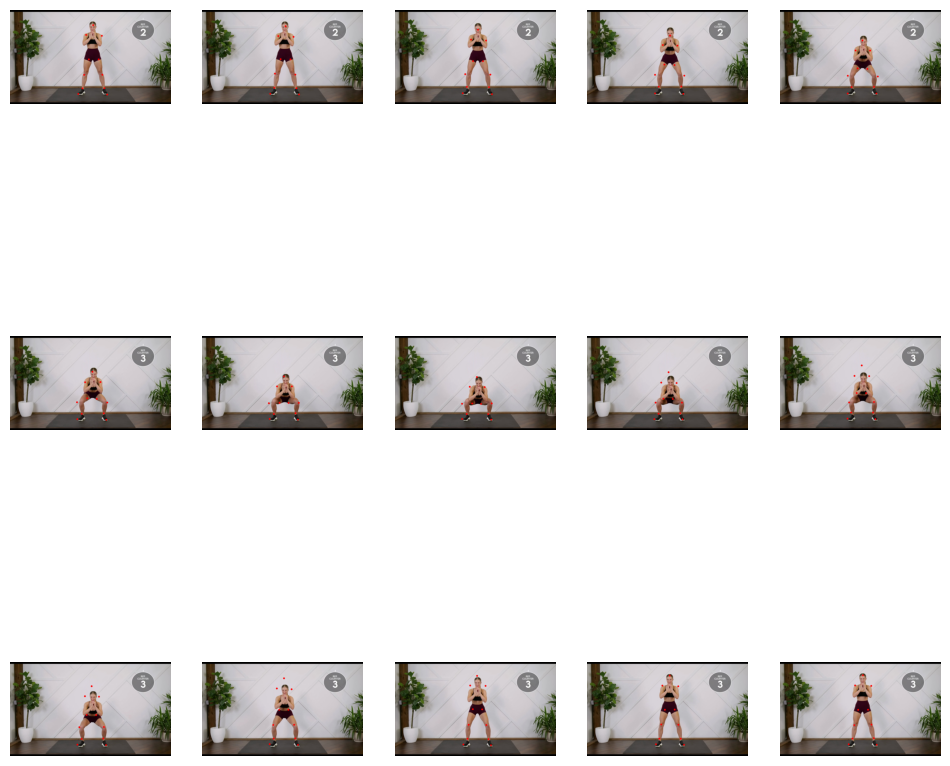

n = 068


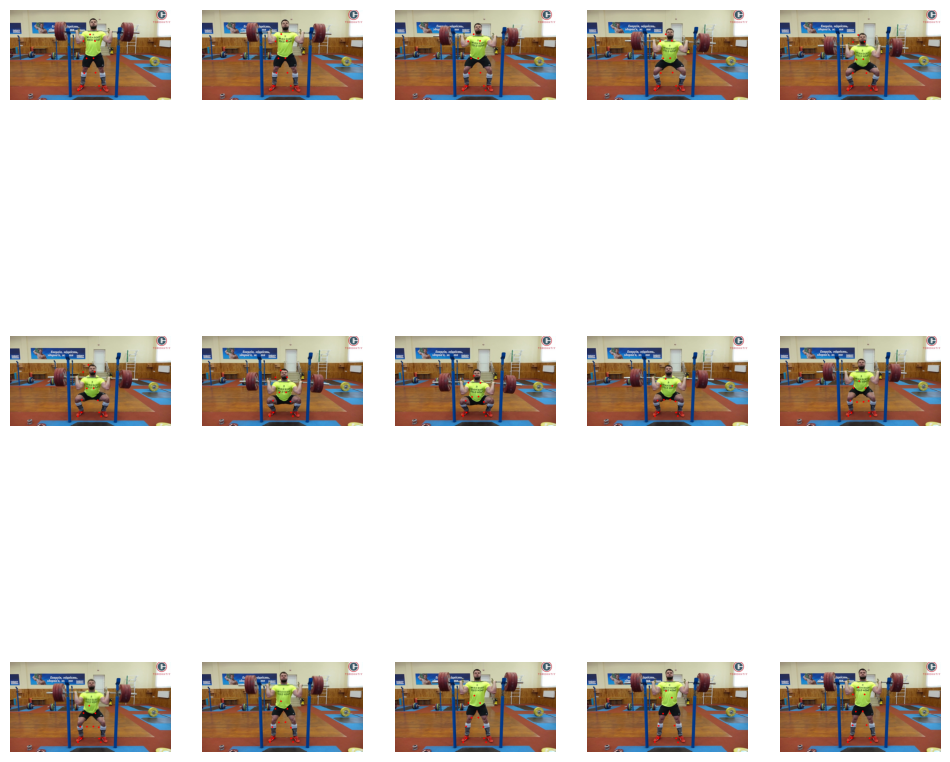

n = 069


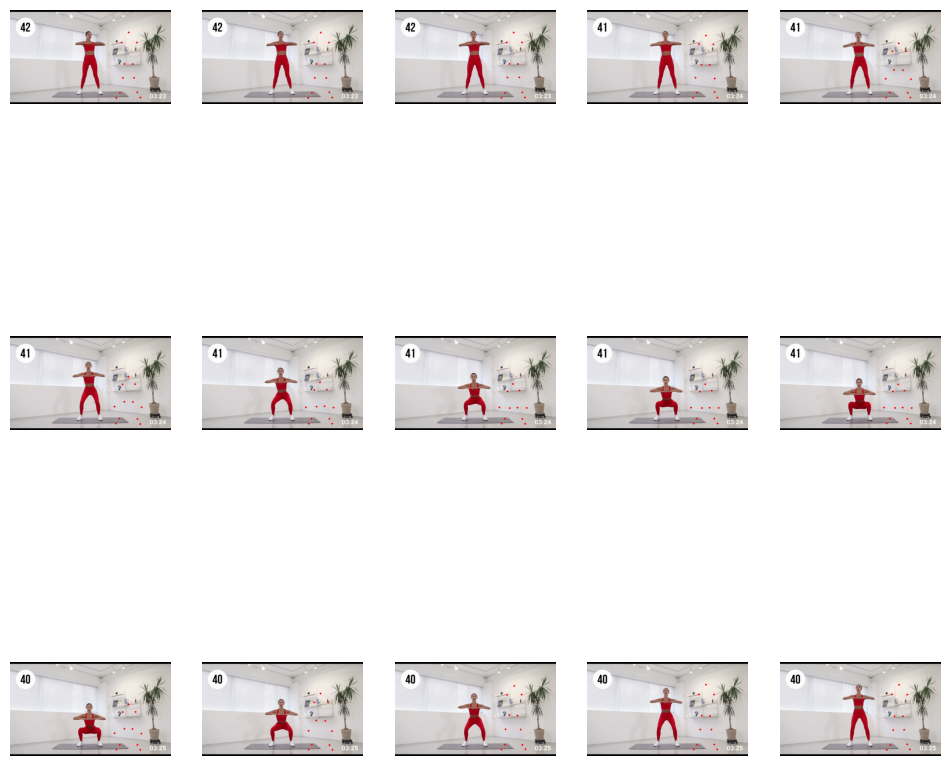

n = 070


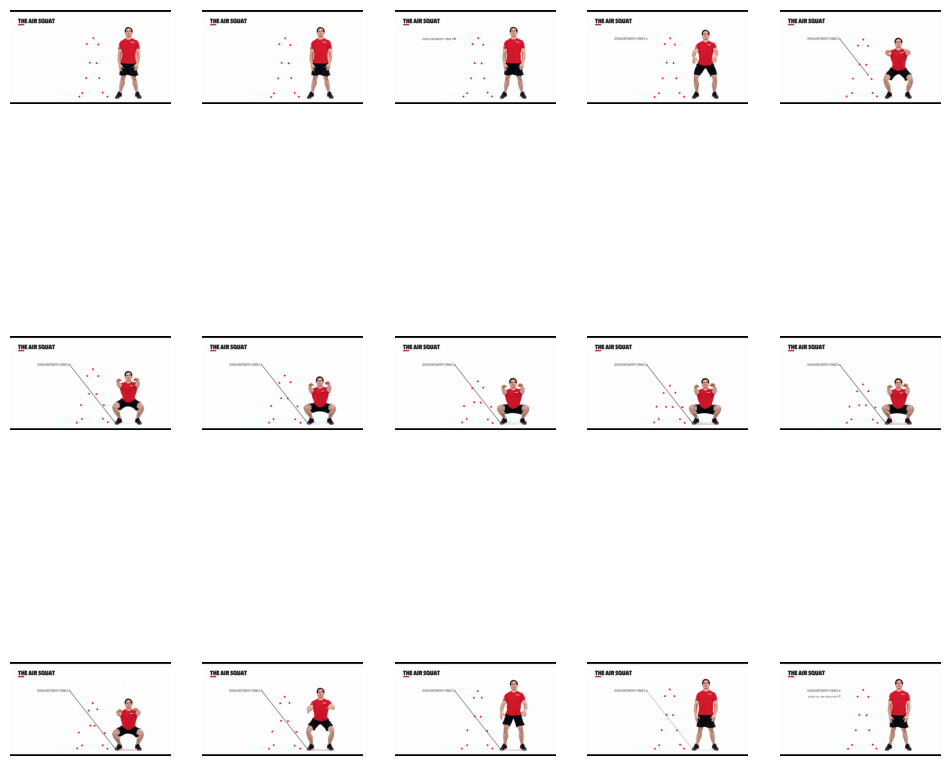

n = 071


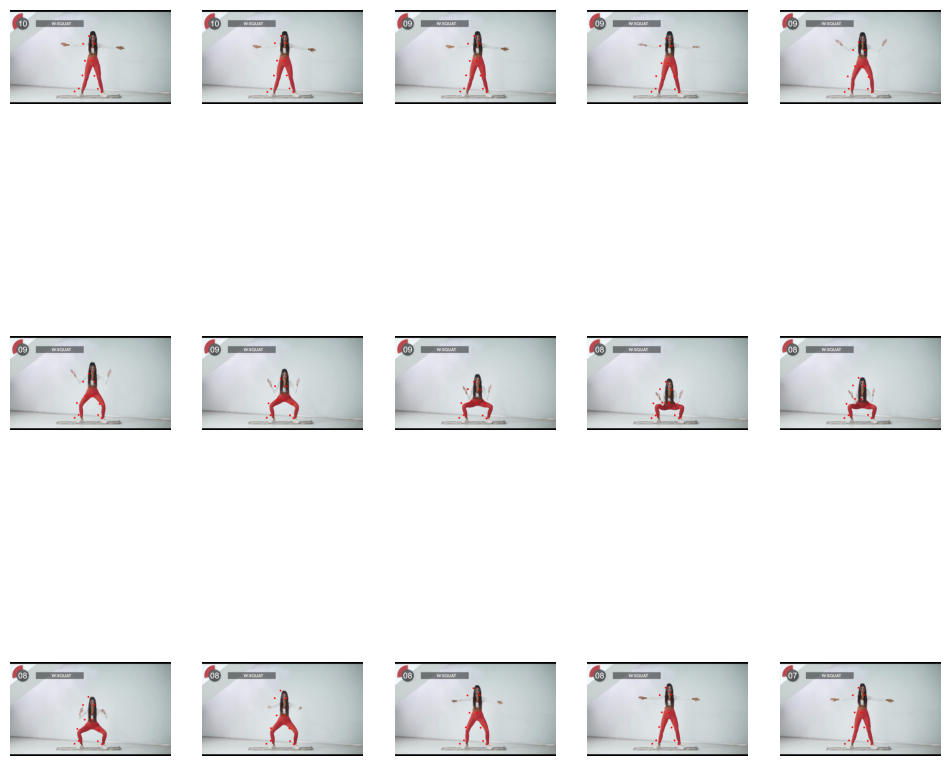

n = 072


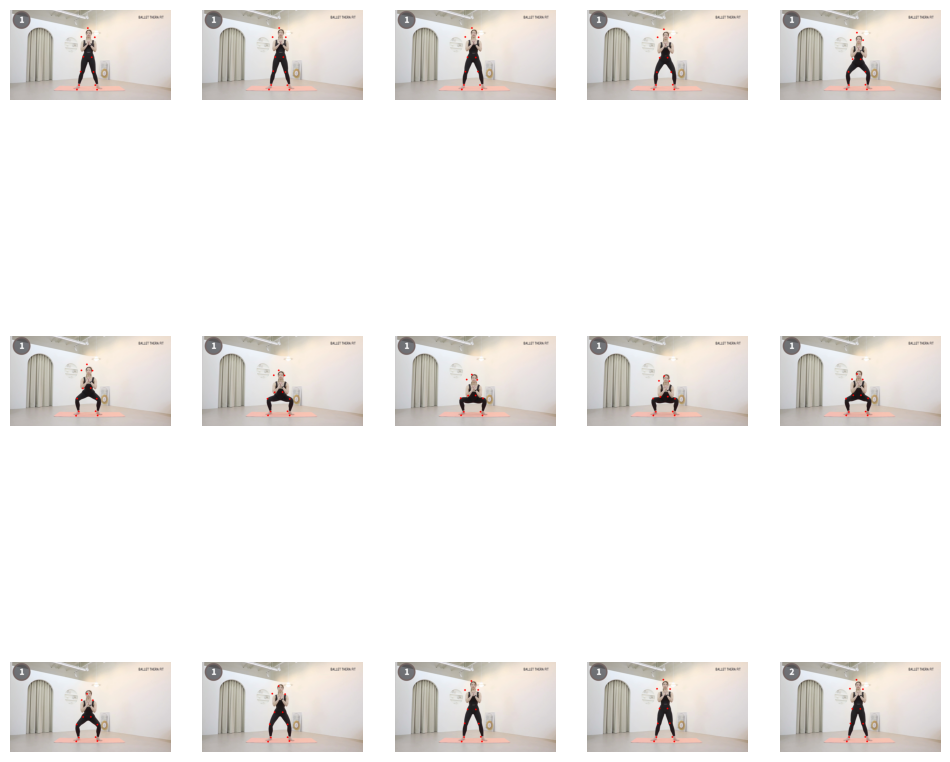

In [82]:
# # n = np.random.randint(0, len(csv_name))
# # n = 20


# for n in range(26, 73):
#     if n < 10:
#         n = f'00{n}'
#     elif n < 100:
#         n = f'0{n}'
#     else:
#         n = f'{n}'
#     print(f'n = {n}')

#     img_list = os.listdir(f'./data/total/2_2_image/{n}/')
#     img_list = sorted(img_list)
#     fig, ax = plt.subplots(3, 5, figsize = (12,12))

#     for i in range(globals()[f'df{n}'].shape[0]):

#         background = cv2.imread(f'./data/total/2_2_image/{n}/' + img_list[i])
#         background = cv2.cvtColor(background, cv2.COLOR_BGR2RGB)
#         temp = globals()[f'df{n}'].iloc[i]
#         temp = np.array(temp)
#         temp = temp.reshape(11, 2)

#         for j in temp:
#             cx = int(j[0]*background.shape[1])
#             cy = int(j[1]*background.shape[0])
#             cv2.circle(background, (cx, cy), radius=5, color=(255,0,0), thickness=10)

#         plt.subplot(3, 5, i + 1)
#         plt.imshow(background)
#         plt.axis('off')
    
#     plt.show()

<br>

## 2. train, test data split

<br>

1. 데이터프레임을 넘파이 배열로 변환한다
2. flatten()을 하여 1차원 배열로 바꾼다

In [14]:
# (연습)

X0 = df00.iloc[0]
y0 = df00.iloc[1:]

print(f'X0 shape = {X0.shape}, y0 shape = {y0.shape}')

X0 shape = (22,), y0 shape = (14, 22)


In [15]:
# (연습)

X0_arr = np.array(X0)
print(X0_arr.shape)
X0_arr

(22,)


array([0.48919, 0.16059, 0.61322, 0.2589 , 0.35582, 0.26689, 0.57819,
       0.50933, 0.40289, 0.51002, 0.63191, 0.71523, 0.35083, 0.71906,
       0.66521, 0.89063, 0.3175 , 0.89752, 0.77351, 0.95428, 0.22593,
       0.96713])

In [16]:
# (연습)

X29 = df29.iloc[0]
print(f'X29 shape = {X29.shape}')

X29_arr = np.array(X29)
print(X29_arr.shape)
X29_arr

X29 shape = (22,)
(22,)


array([0.39451, 0.28699, 0.51257, 0.36082, 0.27555, 0.35744, 0.46209,
       0.53346, 0.3304 , 0.5306 , 0.50841, 0.68323, 0.30886, 0.68184,
       0.55955, 0.8223 , 0.24603, 0.81298, 0.59532, 0.85957, 0.22992,
       0.85717])

In [17]:
# (연습)

X_tot = np.array([X0_arr, X29_arr])
print(f'X_tot shape = {X_tot.shape}')
X_tot

X_tot shape = (2, 22)


array([[0.48919, 0.16059, 0.61322, 0.2589 , 0.35582, 0.26689, 0.57819,
        0.50933, 0.40289, 0.51002, 0.63191, 0.71523, 0.35083, 0.71906,
        0.66521, 0.89063, 0.3175 , 0.89752, 0.77351, 0.95428, 0.22593,
        0.96713],
       [0.39451, 0.28699, 0.51257, 0.36082, 0.27555, 0.35744, 0.46209,
        0.53346, 0.3304 , 0.5306 , 0.50841, 0.68323, 0.30886, 0.68184,
        0.55955, 0.8223 , 0.24603, 0.81298, 0.59532, 0.85957, 0.22992,
        0.85717]])

In [13]:
df000

,0,1,2,3,4,5,6,7,8,9,...,12,13,14,15,16,17,18,19,20,21
Unnamed: 0,,,,,,,,,,,,,,,,,,,,,
0,0.48919,0.16059,0.61322,0.25890,0.35582,0.26689,0.57819,0.50933,0.40289,0.51002,...,0.35083,0.71906,0.66521,0.89063,0.31750,0.89752,0.77351,0.95428,0.22593,0.96713
1,0.49163,0.16628,0.61065,0.26227,0.35769,0.26975,0.57721,0.50601,0.40038,0.50728,...,0.35245,0.71909,0.66995,0.89037,0.31936,0.89529,0.77325,0.95728,0.22997,0.96488
2,0.49316,0.16503,0.61507,0.26085,0.35974,0.26356,0.57302,0.50594,0.40222,0.50679,...,0.35336,0.71335,0.66339,0.88898,0.32171,0.88589,0.77177,0.95322,0.23218,0.95883
3,0.48892,0.16060,0.61782,0.25734,0.36460,0.26332,0.57428,0.50715,0.39885,0.50679,...,0.35030,0.71245,0.66759,0.88732,0.32016,0.89072,0.77949,0.95316,0.22272,0.96346
4,0.49480,0.17635,0.61342,0.26889,0.36214,0.27765,0.57676,0.51873,0.40431,0.52089,...,0.32796,0.69363,0.67339,0.88687,0.32720,0.89166,0.79428,0.95257,0.22187,0.96048
5,0.48943,0.25601,0.63725,0.35166,0.34624,0.35736,0.57755,0.58792,0.39657,0.59001,...,0.24506,0.72636,0.68440,0.90020,0.30141,0.90502,0.80142,0.95183,0.20816,0.96640
6,0.48558,0.37706,0.63720,0.46092,0.33456,0.46502,0.58080,0.66779,0.39735,0.67057,...,0.19607,0.75728,0.68085,0.89946,0.31003,0.90448,0.79605,0.95214,0.21249,0.96406
7,0.48649,0.45039,0.64286,0.53784,0.34203,0.54252,0.58648,0.72742,0.42370,0.72943,...,0.19989,0.75606,0.68974,0.89698,0.31469,0.89966,0.79344,0.95027,0.21757,0.96391
8,0.49162,0.46921,0.64189,0.55912,0.33913,0.55958,0.58638,0.74649,0.42208,0.74985,...,0.20591,0.76167,0.69248,0.89828,0.31348,0.90253,0.79119,0.94583,0.22030,0.96077


In [12]:
df000.iloc[[0]].shape

(1, 22)

In [24]:
# 1. 데이터프레임을 불러온다.
# 2. df를 tempX, tempY로 분리한다
# 3. tempX, tempY를 1차원 넘파이 배열로 만든다.
# 4. 넘파이 배열들을 X, y에 모아서 인/아웃풋 데이터셋을 완성한다.

# df000 ~ df077.iloc[0] -> X_train
# df000 ~ df077.iloc[1:] -> y_train

arrX = []
arrY = []

for no, i in enumerate(range(78)):
    if i < 10:
        i = f'00{i}'
    elif i < 100:
        i = f'0{i}'
    else:
        i = f'{i}'
        
#     print(no, i)
    tempX = globals()[f'df{i}'].iloc[0]
    tempY = globals()[f'df{i}'].iloc[1:]
#     print(tempX.shape, tempY.shape)

    tempX = np.array(tempX)
    tempY = np.array(tempY)
#     print(tempX.shape, tempY.shape)

    tempY = tempY.flatten() # 일차원 넘파이 배열로 변경
#     tempY = list(tempY)
#     print(tempX.shape, tempY.shape)

    arrX.append(tempX)
    arrY.append(tempY)
    
#     print()
    
X_train = np.array(arrX)
y_train = np.array(arrY)
 
print(f'X_train.shape = {X_train.shape}, y_train.shape = {y_train.shape}')

X_train.shape = (78, 22), y_train.shape = (78, 308)


In [25]:
# 1. 데이터프레임을 불러온다.
# 2. df를 tempX, tempY로 분리한다
# 3. tempX, tempY를 1차원 넘파이 배열로 만든다.
# 4. 넘파이 배열들을 X, y에 모아서 인/아웃풋 데이터셋을 완성한다.

# df078 ~ df087.iloc[0] -> X_test
# df078 ~ df087.iloc[1:] -> y_test

arrX = []
arrY = []

for no, i in enumerate(range(78, 88)):
    if i < 10:
        i = f'00{i}'
    elif i < 100:
        i = f'0{i}'
    else:
        i = f'{i}'
        
#     print(no, i)
    tempX = globals()[f'df{i}'].iloc[0]
    tempY = globals()[f'df{i}'].iloc[1:]
#     print(tempX.shape, tempY.shape)

    tempX = np.array(tempX)
    tempY = np.array(tempY)
#     print(tempX.shape, tempY.shape)

    tempY = tempY.flatten() # 일차원 넘파이 배열로 변경
#     tempY = list(tempY)
#     print(tempX.shape, tempY.shape)

    arrX.append(tempX)
    arrY.append(tempY)
    
#     print()
    
X_test = np.array(arrX)
y_test = np.array(arrY)
 
print(f'X_test.shape = {X_test.shape}, y_test.shape = {y_test.shape}')

X_test.shape = (10, 22), y_test.shape = (10, 308)


In [18]:
# # 1. 데이터프레임을 불러온다.
# # 2. df를 tempX, tempY로 분리한다
# # 3. tempX, tempY를 1차원 넘파이 배열로 만든다.
# # 4. 넘파이 배열들을 X, y에 모아서 인/아웃풋 데이터셋을 완성한다.

# arrX = []
# arrY = []

# for no, i in enumerate(range(78)):
#     if i < 10:
#         i = f'0{i}'
#     if i == 30:
#         pass
#     else:
#     #     print(no, i)
#         tempX = globals()[f'df{i}'].iloc[0]
#         tempY = globals()[f'df{i}'].iloc[1:]
#     #     print(tempX.shape, tempY.shape)

#         tempX = np.array(tempX)
#         tempY = np.array(tempY)
#     #     print(tempX.shape, tempY.shape)

#         tempY = tempY.flatten() # 일차원 넘파이 배열로 변경
#     #     tempY = list(tempY)
#     #     print(tempX.shape, tempY.shape)

#         arrX.append(tempX)
#         arrY.append(tempY)
    
# #     print()
    
# X = np.array(arrX)
# y = np.array(arrY)
 
# print(f'X.shape = {X.shape}, y.shape = {y.shape}')

In [19]:
X[0:30].shape, y[0:30].shape

((30, 22), (30, 308))

In [20]:
# # from sklearn.model_selection import train_test_split

# # # X_train, X_test, Y_train, Y_test로 나누기
# # X_train, X_test, y_train, y_test = train_test_split(X, y, test_size =0.1, random_state=42)

# # 이미지와 매칭을 통해 정확도를 눈으로 확인해야 하므로, train : 0~29, test : 30 ~ 33으로 나눈다
# X_train = X[0:30]
# y_train = y[0:30]
# X_test = X[30:34]
# y_test = y[30:34]

# print(f'X_train shape = {X_train.shape}, X_test shape = {X_test.shape}')
# print(f'y_train shape = {y_train.shape}, y_test shape = {y_test.shape}')

X_train shape = (30, 22), X_test shape = (3, 22)
y_train shape = (30, 308), y_test shape = (3, 308)


## 3. Modeling

In [19]:
X_train[0].shape

(22,)

In [20]:
from tensorflow.keras import Sequential, Model
from tensorflow.keras.layers import Dense, Flatten, Dropout, LSTM
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

In [150]:
model = Sequential()
model.add(Flatten(input_shape = X_train[0].shape))
model.add(Dense(128, activation='linear'))
model.add(Dense(256, activation='linear'))
# model.add(Dense(256, activation='linear'))
model.add(Dropout(0.4))
# model.add(Dense(512, activation='linear'))
model.add(Dense(512, activation='linear'))
model.add(Dropout(0.4))
# model.add(Dense(512, activation='linear'))
model.add(Dense(384, activation='linear'))
model.add(Dropout(0.4))
model.add(Dense(384, activation='linear'))
model.add(Dense(308, activation='linear'))

model.compile(optimizer='adam', loss='mse', metrics=['mse'])
model.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten_5 (Flatten)         (None, 22)                0         
                                                                 
 dense_30 (Dense)            (None, 128)               2944      
                                                                 
 dense_31 (Dense)            (None, 256)               33024     
                                                                 
 dropout_15 (Dropout)        (None, 256)               0         
                                                                 
 dense_32 (Dense)            (None, 512)               131584    
                                                                 
 dropout_16 (Dropout)        (None, 512)               0         
                                                                 
 dense_33 (Dense)            (None, 384)              

In [151]:
history = model.fit(X_train, y_train, 
                    validation_split=0.1,
          batch_size=32, epochs=100)

Epoch 1/100
3/3 [==============================] - 0s 90ms/step - loss: 0.5259 - mse: 0.5259 - val_loss: 0.1341 - val_mse: 0.1341
Epoch 2/100
3/3 [==============================] - 0s 22ms/step - loss: 0.1787 - mse: 0.1787 - val_loss: 0.0255 - val_mse: 0.0255
Epoch 3/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0609 - mse: 0.0609 - val_loss: 0.0122 - val_mse: 0.0122
Epoch 4/100
3/3 [==============================] - 0s 18ms/step - loss: 0.0333 - mse: 0.0333 - val_loss: 0.0169 - val_mse: 0.0169
Epoch 5/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0262 - mse: 0.0262 - val_loss: 0.0086 - val_mse: 0.0086
Epoch 6/100
3/3 [==============================] - 0s 18ms/step - loss: 0.0240 - mse: 0.0240 - val_loss: 0.0176 - val_mse: 0.0176
Epoch 7/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0185 - mse: 0.0185 - val_loss: 0.0147 - val_mse: 0.0147
Epoch 8/100
3/3 [==============================] - 0s 18ms/step - loss: 0.0188 - mse: 0.01

3/3 [==============================] - 0s 15ms/step - loss: 0.0017 - mse: 0.0017 - val_loss: 0.0060 - val_mse: 0.0060
Epoch 64/100
3/3 [==============================] - 0s 15ms/step - loss: 0.0016 - mse: 0.0016 - val_loss: 0.0076 - val_mse: 0.0076
Epoch 65/100
3/3 [==============================] - 0s 15ms/step - loss: 0.0017 - mse: 0.0017 - val_loss: 0.0049 - val_mse: 0.0049
Epoch 66/100
3/3 [==============================] - 0s 15ms/step - loss: 0.0018 - mse: 0.0018 - val_loss: 0.0079 - val_mse: 0.0079
Epoch 67/100
3/3 [==============================] - 0s 15ms/step - loss: 0.0017 - mse: 0.0017 - val_loss: 0.0060 - val_mse: 0.0060
Epoch 68/100
3/3 [==============================] - 0s 15ms/step - loss: 0.0016 - mse: 0.0016 - val_loss: 0.0090 - val_mse: 0.0090
Epoch 69/100
3/3 [==============================] - 0s 16ms/step - loss: 0.0018 - mse: 0.0018 - val_loss: 0.0062 - val_mse: 0.0062
Epoch 70/100
3/3 [==============================] - 0s 15ms/step - loss: 0.0017 - mse: 0.0017 - 

<br> <br>

## 4. 학습 결과 및 예측 결과 확인

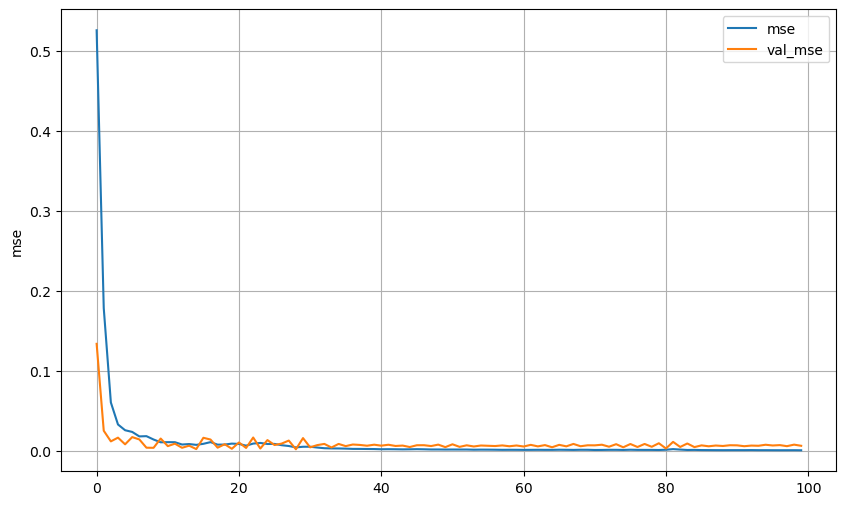

In [152]:
plt.figure(figsize=(10,6))

plt.plot(history.history['mse'])
plt.plot(history.history['val_mse'])
plt.ylabel('mse')
plt.legend(['mse', 'val_mse'])
plt.grid()

plt.show()

In [154]:
pred = model.predict(X_test)

1/1 [==============================] - 0s 15ms/step


In [35]:
print(f'pred shape = {pred.shape}')
print(f'pred[0] shape = {pred[0].shape}')

pred shape = (10, 308)
pred[0] shape = (308,)


In [71]:
sample1 = y_test[0]
sample1 = sample1.reshape((14, 11, 2))
sample1

array([[[0.52933, 0.19843],
        [0.57747, 0.27193],
        [0.48178, 0.27211],
        [0.55841, 0.50276],
        [0.50444, 0.50423],
        [0.5732 , 0.66303],
        [0.48895, 0.66935],
        [0.57782, 0.81324],
        [0.4897 , 0.81816],
        [0.60902, 0.86342],
        [0.46258, 0.87047]],

       [[0.5269 , 0.19819],
        [0.57864, 0.27761],
        [0.48122, 0.27955],
        [0.55749, 0.50573],
        [0.50168, 0.5084 ],
        [0.57762, 0.66444],
        [0.48571, 0.67036],
        [0.57811, 0.81599],
        [0.48823, 0.81904],
        [0.60413, 0.86328],
        [0.45803, 0.8687 ]],

       [[0.52998, 0.23487],
        [0.57622, 0.30248],
        [0.48133, 0.30652],
        [0.55877, 0.52763],
        [0.50032, 0.52672],
        [0.58485, 0.66397],
        [0.48009, 0.6634 ],
        [0.58211, 0.82167],
        [0.48747, 0.82214],
        [0.60981, 0.8696 ],
        [0.45529, 0.87128]],

       [[0.52888, 0.29459],
        [0.57535, 0.35688],
        [0.481

In [117]:
sample1 = pred[1]
sample1 = sample1.reshape((14, 11, 2))
sample1

array([[[0.40479416, 0.1440154 ],
        [0.4525231 , 0.23106475],
        [0.3756454 , 0.24793714],
        [0.4580166 , 0.43133846],
        [0.4096502 , 0.442563  ],
        [0.45983237, 0.56938756],
        [0.35522655, 0.57059526],
        [0.46229938, 0.72388476],
        [0.37881607, 0.72700715],
        [0.4913835 , 0.78814024],
        [0.3604574 , 0.7827559 ]],

       [[0.39889017, 0.16507062],
        [0.480983  , 0.23909691],
        [0.40237463, 0.22684087],
        [0.42711657, 0.4214703 ],
        [0.39878413, 0.45497766],
        [0.4525051 , 0.61026186],
        [0.3578472 , 0.57789826],
        [0.47086114, 0.7127908 ],
        [0.382475  , 0.7116396 ],
        [0.48278272, 0.75603414],
        [0.38468385, 0.7698308 ]],

       [[0.42767665, 0.23000799],
        [0.43777838, 0.2907961 ],
        [0.39462608, 0.28400034],
        [0.4277435 , 0.4757513 ],
        [0.40191883, 0.45142123],
        [0.4771453 , 0.5812428 ],
        [0.38620868, 0.5629277 ],
        [0

### 결과 확인

In [49]:
for i in range(pred.shape[0]):
#     print(i)
    temp_pred = pred[{i}].reshape((14, 11, 2))
    temp_y_test = y_test[{i}].reshape((14, 11, 2))
#     globals()[f'pred{i}']

0
1
2
3
4
5
6
7
8
9


In [172]:
i = 0

temp_pred = pred[i].reshape((14, 11, 2))
temp_y_test = y_test[i].reshape((14, 11, 2))
# temp_y_test = np.array(df000[1:]).reshape((14, 11, 2))

print(f'temp_pred shape {temp_pred.shape}')
print(f'temp_y_test shape {temp_y_test.shape}')

temp_pred shape (14, 11, 2)
temp_y_test shape (14, 11, 2)


In [166]:
temp_pred[0]

array([[0.4441279 , 0.17639048],
       [0.5187892 , 0.27204224],
       [0.3987108 , 0.25179216],
       [0.44652623, 0.45683402],
       [0.4316029 , 0.48577642],
       [0.5217879 , 0.5785234 ],
       [0.41547114, 0.5799183 ],
       [0.5168851 , 0.74427176],
       [0.4121918 , 0.73309076],
       [0.51474375, 0.7928544 ],
       [0.36140698, 0.73982966]], dtype=float32)

In [167]:
temp_y_test[0]

array([[0.52933, 0.19843],
       [0.57747, 0.27193],
       [0.48178, 0.27211],
       [0.55841, 0.50276],
       [0.50444, 0.50423],
       [0.5732 , 0.66303],
       [0.48895, 0.66935],
       [0.57782, 0.81324],
       [0.4897 , 0.81816],
       [0.60902, 0.86342],
       [0.46258, 0.87047]])

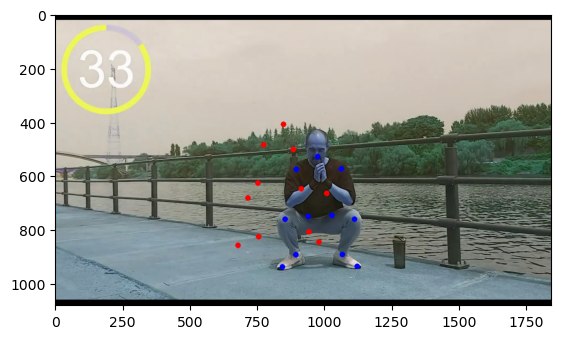

In [173]:
number = i + 78

img = cv2.imread(f'./data/total_0511/2_images/2_2_images/0{number}/exercise_08.jpg')
background = np.zeros(shape=img.shape, dtype=np.uint8) + 255

# pred 좌표
for i in temp_pred[7]:
    cx = int(i[0]*img.shape[1])
    cy = int(i[1]*img.shape[0])
    cv2.circle(img, (cx, cy), radius=5, color=(255,0,0), thickness=10)
    
# y_test 좌표
for i in temp_y_test[7]:
    cx = int(i[0]*img.shape[1])
    cy = int(i[1]*img.shape[0])
    cv2.circle(img, (cx, cy), radius=5, color=(0,0,255), thickness=10)

plt.imshow(img)

<br><br>

### 중앙에서 스쿼트 하는 데이터셋으로 결과를 확인해보자

In [33]:
df_test1 = pd.read_csv('./data/csv/squat_test/squat_skeleton_test1.csv')
df_test1.set_index('Unnamed: 0', inplace=True)
df_test1

,0,1,2,3,4,5,6,7,8,9,...,12,13,14,15,16,17,18,19,20,21
Unnamed: 0,,,,,,,,,,,,,,,,,,,,,
0,0.52282,0.20917,0.63405,0.28787,0.41422,0.28931,0.60158,0.52224,0.43810,0.52067,...,0.38985,0.70141,0.67151,0.86796,0.37314,0.87897,0.77374,0.93052,0.30715,0.94436
1,0.52437,0.19834,0.64149,0.27693,0.40765,0.27656,0.60163,0.51825,0.43499,0.51819,...,0.38997,0.70295,0.67759,0.87011,0.37187,0.87964,0.77727,0.93008,0.30153,0.94267
2,0.51838,0.20569,0.62892,0.28898,0.40321,0.28287,0.58523,0.52376,0.42283,0.52309,...,0.36834,0.70104,0.66871,0.87101,0.36090,0.88454,0.78668,0.92759,0.28561,0.94499
3,0.52131,0.24280,0.63444,0.33241,0.40525,0.32880,0.58625,0.56113,0.41859,0.56266,...,0.32693,0.71950,0.68645,0.87558,0.35084,0.88793,0.79470,0.92411,0.28307,0.94281
4,0.52214,0.32690,0.63661,0.40665,0.40897,0.40702,0.58928,0.62119,0.42787,0.62006,...,0.28918,0.73512,0.69065,0.87924,0.35028,0.88285,0.79318,0.92452,0.27180,0.94137
5,0.51826,0.40935,0.63468,0.48309,0.40568,0.48085,0.59940,0.68288,0.43900,0.67961,...,0.26824,0.74758,0.69151,0.87772,0.35248,0.88548,0.78999,0.92423,0.27862,0.94192
6,0.52084,0.45466,0.63403,0.52722,0.40751,0.52649,0.60720,0.71865,0.44874,0.71855,...,0.25720,0.75411,0.69026,0.87981,0.35526,0.88694,0.78693,0.92532,0.27420,0.93757
7,0.52626,0.46401,0.64044,0.54006,0.40519,0.53953,0.60978,0.73478,0.45267,0.73510,...,0.26514,0.75249,0.68363,0.88034,0.36222,0.88814,0.78292,0.92242,0.28483,0.93967
8,0.52304,0.46044,0.63813,0.54033,0.40838,0.53646,0.60478,0.73242,0.45076,0.73262,...,0.26285,0.75072,0.68161,0.87913,0.36122,0.88696,0.78442,0.92240,0.28092,0.93621


In [34]:
test1_input = df_test1.iloc[0]
test1_output = df_test1.iloc[1:]
print(test1_input.shape, test1_output.shape)

test1_input = np.array(test1_input)
test1_output = np.array(test1_output)
print(test1_input.shape, test1_output.shape)

test1_input = test1_input.reshape(1, 22)
test1_output = test1_output.flatten()
test1_output = test1_output.reshape(1, 308)
print(test1_input.shape, test1_output.shape)

(22,) (14, 22)
(22,) (14, 22)
(1, 22) (1, 308)


In [35]:
test1_input

array([[0.52282, 0.20917, 0.63405, 0.28787, 0.41422, 0.28931, 0.60158,
        0.52224, 0.4381 , 0.52067, 0.6515 , 0.70376, 0.38985, 0.70141,
        0.67151, 0.86796, 0.37314, 0.87897, 0.77374, 0.93052, 0.30715,
        0.94436]])

In [36]:
test1_output

array([[0.52437, 0.19834, 0.64149, 0.27693, 0.40765, 0.27656, 0.60163,
        0.51825, 0.43499, 0.51819, 0.64798, 0.69877, 0.38997, 0.70295,
        0.67759, 0.87011, 0.37187, 0.87964, 0.77727, 0.93008, 0.30153,
        0.94267, 0.51838, 0.20569, 0.62892, 0.28898, 0.40321, 0.28287,
        0.58523, 0.52376, 0.42283, 0.52309, 0.6648 , 0.69343, 0.36834,
        0.70104, 0.66871, 0.87101, 0.3609 , 0.88454, 0.78668, 0.92759,
        0.28561, 0.94499, 0.52131, 0.2428 , 0.63444, 0.33241, 0.40525,
        0.3288 , 0.58625, 0.56113, 0.41859, 0.56266, 0.72442, 0.70689,
        0.32693, 0.7195 , 0.68645, 0.87558, 0.35084, 0.88793, 0.7947 ,
        0.92411, 0.28307, 0.94281, 0.52214, 0.3269 , 0.63661, 0.40665,
        0.40897, 0.40702, 0.58928, 0.62119, 0.42787, 0.62006, 0.74923,
        0.73075, 0.28918, 0.73512, 0.69065, 0.87924, 0.35028, 0.88285,
        0.79318, 0.92452, 0.2718 , 0.94137, 0.51826, 0.40935, 0.63468,
        0.48309, 0.40568, 0.48085, 0.5994 , 0.68288, 0.439  , 0.67961,
      

In [37]:
pred1 = model.predict(test1_input)

1/1 [==============================] - 0s 241ms/step


In [38]:
pred1

array([[0.4484428 , 0.16664468, 0.56854874, 0.2692584 , 0.3454321 ,
        0.25545526, 0.5070131 , 0.4730652 , 0.4035508 , 0.47238198,
        0.57287693, 0.6238234 , 0.34168753, 0.59406453, 0.58382326,
        0.7639029 , 0.3733277 , 0.7638314 , 0.6364072 , 0.81741685,
        0.27294058, 0.8122588 , 0.461938  , 0.16397053, 0.54450583,
        0.2565134 , 0.34032568, 0.25435844, 0.50721   , 0.47487664,
        0.40786815, 0.48701778, 0.5847739 , 0.62900394, 0.3154936 ,
        0.6132657 , 0.58128566, 0.7663678 , 0.3126951 , 0.7801365 ,
        0.64152807, 0.8230682 , 0.27206513, 0.8156831 , 0.43742996,
        0.2216966 , 0.5344605 , 0.26883167, 0.33690313, 0.2968204 ,
        0.50014234, 0.5027688 , 0.40439972, 0.47463816, 0.6027646 ,
        0.61797845, 0.2974533 , 0.64328945, 0.5826706 , 0.8035595 ,
        0.34052032, 0.78263056, 0.634889  , 0.8122126 , 0.25658384,
        0.7967107 , 0.42856634, 0.25483674, 0.55547017, 0.33607796,
        0.37234372, 0.34181064, 0.47719756, 0.52

In [39]:
test_pred = pred1.reshape((14, 11, 2))
test_pred

array([[[0.4484428 , 0.16664468],
        [0.56854874, 0.2692584 ],
        [0.3454321 , 0.25545526],
        [0.5070131 , 0.4730652 ],
        [0.4035508 , 0.47238198],
        [0.57287693, 0.6238234 ],
        [0.34168753, 0.59406453],
        [0.58382326, 0.7639029 ],
        [0.3733277 , 0.7638314 ],
        [0.6364072 , 0.81741685],
        [0.27294058, 0.8122588 ]],

       [[0.461938  , 0.16397053],
        [0.54450583, 0.2565134 ],
        [0.34032568, 0.25435844],
        [0.50721   , 0.47487664],
        [0.40786815, 0.48701778],
        [0.5847739 , 0.62900394],
        [0.3154936 , 0.6132657 ],
        [0.58128566, 0.7663678 ],
        [0.3126951 , 0.7801365 ],
        [0.64152807, 0.8230682 ],
        [0.27206513, 0.8156831 ]],

       [[0.43742996, 0.2216966 ],
        [0.5344605 , 0.26883167],
        [0.33690313, 0.2968204 ],
        [0.50014234, 0.5027688 ],
        [0.40439972, 0.47463816],
        [0.6027646 , 0.61797845],
        [0.2974533 , 0.64328945],
        [0

In [40]:
test1_output_ = test1_output.reshape((14, 11, 2))
test1_output_

array([[[0.52437, 0.19834],
        [0.64149, 0.27693],
        [0.40765, 0.27656],
        [0.60163, 0.51825],
        [0.43499, 0.51819],
        [0.64798, 0.69877],
        [0.38997, 0.70295],
        [0.67759, 0.87011],
        [0.37187, 0.87964],
        [0.77727, 0.93008],
        [0.30153, 0.94267]],

       [[0.51838, 0.20569],
        [0.62892, 0.28898],
        [0.40321, 0.28287],
        [0.58523, 0.52376],
        [0.42283, 0.52309],
        [0.6648 , 0.69343],
        [0.36834, 0.70104],
        [0.66871, 0.87101],
        [0.3609 , 0.88454],
        [0.78668, 0.92759],
        [0.28561, 0.94499]],

       [[0.52131, 0.2428 ],
        [0.63444, 0.33241],
        [0.40525, 0.3288 ],
        [0.58625, 0.56113],
        [0.41859, 0.56266],
        [0.72442, 0.70689],
        [0.32693, 0.7195 ],
        [0.68645, 0.87558],
        [0.35084, 0.88793],
        [0.7947 , 0.92411],
        [0.28307, 0.94281]],

       [[0.52214, 0.3269 ],
        [0.63661, 0.40665],
        [0.408

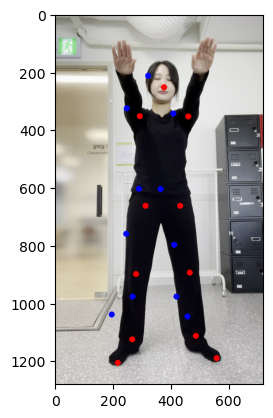

In [41]:
img = cv2.imread('./data/images/sample2/exercise_01.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
background = np.zeros(shape=img.shape, dtype=np.uint8) + 255

for i in test1_output_[0]:
    cx = int(i[0]*img.shape[1])
    cy = int(i[1]*img.shape[0])
    cv2.circle(img, (cx, cy), radius=5, color=(255,0,0), thickness=10)
    
for i in test_pred[0]:
    cx = int(i[0]*img.shape[1])
    cy = int(i[1]*img.shape[0])
    cv2.circle(img, (cx, cy), radius=5, color=(0,0,255), thickness=10)

plt.imshow(img)

<br><br>

## 학습 데이터 가지고 확인해보기

#### 이미지 레이블까지 해서 제대로 데이터셋 다시 정리해야 할듯..

In [69]:
from tensorflow.keras.utils import plot_model

plot_model(model, show_shapes=True, show_dtype=True, show_layer_activations=True)

You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) for plot_model to work.
